 ### PREDICTION OF THE SUCCESS OF START-UPS USING UNBIASED CLASSIFICATION MACHINE LEARNING MODELS 
 
**Problem Statement**
This notebook contains the final part of the research work to build a supervised learning classification machine learning model that facilitates the prediction of the success of a company based on situational informtion only available at the point of seeking financing by the company.. 

**Data**
Historical data about companies was sourced from Crunchbase. Crunchbase tracks and collects information about millions of companies and related personnel. Past research works has been carried out using Crunchbase data but features such as company descriptions and people descriptions and other textual features were not used for the model buiding. To further enrich the dataset information from social media was scrapped and analysed for sentiments, however due to Twitter restrictions and unrealistic resources required to scrape for all companies, the Twitter scrapping code though available is not utilised for the final dataset. Natural Language Processing of the organisation description and people description were carried out as will as features engineering of additional features from the raw dataset.

**Models**

The following  ML models will be experimented on with the final dataset.
* Logistic Regression
* RandomForest Classifiers
* SVM Classifers
* Naives Bayes
* LightGBM

 ### Machine Learning Model
 
**Scikit Learn ML Library will be utlised and the following steps carried**
 
  * upload the preprocessed train, validation and test datasets
  * train models and evaluate with validation set
  * Carry out hyperparameter tuning as required.
  * Evaluate and select the best model using the test data.
  

In [34]:
# !pip install lightgbm
# !pip install xgboost

                                              0.0/99.8 MB ? eta -:--:--
                                              0.7/99.8 MB 8.4 MB/s eta 0:00:12
                                              1.2/99.8 MB 6.1 MB/s eta 0:00:17
                                              1.9/99.8 MB 6.0 MB/s eta 0:00:17
                                              2.4/99.8 MB 6.0 MB/s eta 0:00:17
     -                                        2.8/99.8 MB 5.9 MB/s eta 0:00:17
     -                                        3.2/99.8 MB 5.5 MB/s eta 0:00:18
     -                                        3.3/99.8 MB 5.3 MB/s eta 0:00:19
     -                                        3.6/99.8 MB 5.1 MB/s eta 0:00:19
     -                                        4.0/99.8 MB 5.3 MB/s eta 0:00:19
     -                                        4.4/99.8 MB 5.3 MB/s eta 0:00:19
     -                                        4.7/99.8 MB 5.3 MB/s eta 0:00:18
     --                                       5.1/99.8 MB 5

In [1]:
# Import Data Analysis Libraries
import pandas as pd
import numpy as np
import os
import dill
import warnings

# Suppress FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)


# Import Machine Learning Classifiers models Libraries
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
import lightgbm as lgb
from xgboost import XGBClassifier


# Import evaluations modules
#from sklearn.metrics import plot_roc_curve
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import RocCurveDisplay


# Import other needed machine Learning Libraries
from sklearn.preprocessing import StandardScaler, OneHotEncoder,MinMaxScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score, GridSearchCV
from sklearn.feature_selection import SelectPercentile, chi2
from sklearn.pipeline import Pipeline


ImportError: The `scipy` install you are using seems to be broken, (extension modules cannot be imported), please try reinstalling.

In [51]:
# We will load the training, validation and test dataset

train = pd.read_csv("D:\\OneDrive\\Documents\\PERSONAL\\PERSONAL DEVELOPMENT\\"
                "DATA SCIENCE\\Personal Project Portfolio\\PP00017_Prediction of the Success of Start-Ups Using Unbiased Classification ML Models"
                "\\artifacts\\data_transformation\\train_arr.csv")
val = pd.read_csv("D:\\OneDrive\\Documents\\PERSONAL\\PERSONAL DEVELOPMENT\\"
                "DATA SCIENCE\\Personal Project Portfolio\\PP00017_Prediction of the Success of Start-Ups Using Unbiased Classification ML Models"
                "\\artifacts\\data_transformation\\val_arr.csv")
test = pd.read_csv("D:\\OneDrive\\Documents\\PERSONAL\\PERSONAL DEVELOPMENT\\"
                "DATA SCIENCE\\Personal Project Portfolio\\PP00017_Prediction of the Success of Start-Ups Using Unbiased Classification ML Models"
                "\\artifacts\\data_transformation\\test_arr.csv")

In [52]:
train

,0,1,2,3,4,5,6,7,8,9,...,4463,4464,4465,4466,4467,4468,4469,4470,4471,success
0,0.0,0.000000,0.0,0.0,0.0,0.064315,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
1,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,10.050378,0.000000,0.0,0.000000,5.103104,1
2,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
3,0.0,0.000000,0.0,0.0,0.0,0.000000,0.141853,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
4,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
96,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
97,0.0,0.120843,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1
98,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,...,0.0,5.103104,0.0,0.0,0.000000,5.103104,0.0,5.103104,0.000000,1


In [53]:
X_train, y_train, X_val, y_val, X_test, y_test = train.iloc[:, :-1],train.iloc[:, -1], val.iloc[:, :-1], val.iloc[:, -1],test.iloc[:, :-1], test.iloc[:, -1]
                        


In [54]:
# Confirm the dimensions of the train and test dataset
print (X_train.shape,y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape) 

(100, 4472) (100,) (26, 4472) (26,) (32, 4472) (32,)


In [74]:
def fit_and_score_best_model(models,preprocessor_path, X_train, X_test, y_train, y_test):
    """
    Fits and evaluates models passed to it.
    
    Parameters:
    -----------
    models : Dictionary of machine learning models
    X_train : training data (without labels)
    X_test : test data (without labels)
    y_train : training labels
    y_test : test labels
    
    Returns:
    -----------
    The best performing model out of the model passed to it
    
    """
    
    # Set random seed
    np.random.seed(42)
    
    # Make a dictionary to keep model scores
    model_report = {}
        
    # Lopp through models
    for name, model in models.items():
        # Fit the model to the data
        model.fit(X_train, y_train)
       
        # Evaluate the model and append its score to model_report
        model_report[name] = model.score(X_test, y_test)
        
    # To get best model score from dict
    best_model_score = max(sorted(model_report.values()))
      
    # To get best model name from dict
    best_model_name = list(model_report.keys())[
                list(model_report.values()).index(best_model_score)
            ]
    best_model = models[best_model_name]

    if best_model_score < 0.6:
        raise CustomException("No best model found")
           
#     logging.info(f"Best found model on both training and testing dataset")

#     save_object(
#                 file_path=self.model_trainer_config.trained_model_file_path,
#                 obj=best_model
#             )

    return print(f'Best Model: {best_model}, Score: {best_model_score}')

In [76]:
# put models in a dictionary
models = {'Logistic Regression':LogisticRegression(),'SVM': SVC(),'Random Forest': RandomForestClassifier(),
           'XGB': XGBClassifier(), 'LightGBM': lgb.LGBMClassifier() }

best_model = fit_and_score_best_model(models,"D:\\OneDrive\\Documents\\PERSONAL\\PERSONAL DEVELOPMENT\\DATA SCIENCE\\Personal Project Portfolio\\PP00017_Prediction of the Success of Start-Ups Using Unbiased Classification ML Models\\artifacts\\data_transformation\\preprocessor.pkl",
                                      X_train=X_train, X_test=X_val,y_train=y_train, y_test=y_val)

best_model
    


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  i

[LightGBM] [Info] Number of positive: 73, number of negative: 27
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001632 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 466
[LightGBM] [Info] Number of data points in the train set: 100, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.730000 -> initscore=0.994623
[LightGBM] [Info] Start training from score 0.994623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
C:\Users\admin\anaconda3\Lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_d

In [115]:
def load_object(file_path):
    try:
        with open(file_path, "rb") as file_obj:
            return dill.load(file_obj)

    except Exception as e:
        raise CustomException(e, sys)
        
        
def save_object(file_path, obj):
    with open(file_path, 'wb') as file_obj:
        dill.dump(obj, file_obj)

In [116]:
# Add helper function with hyperparameter tuning with GridSearch CV
def evaluate_models(X_train, y_train, X_test, y_test, models, param):
    try:
        """
        This method fits and score the models provided while doing a gridsearch cross
        validation using the parameter grid provided
        
        input: X-train - Training data input features
             y_train - Training data label 
             X_test - Test data input features
             y_test - Test data labels
             models - ML model to experiment with
             param :dict - parameter settings to try as values.
             
        Returns: a dictionary of the a key values pair of model and score
        """ 
                
        report = {}

        for i in range(len(list(models))):
            model = list(models.values())[i]
            para=param[list(models.keys())[i]]

            gs = GridSearchCV(model,para,cv=3, verbose=3)
            gs.fit(X_train,y_train)

            model.set_params(**gs.best_params_)
            model.fit(X_train,y_train)

            #model.fit(X_train, y_train)  # Train model

#             y_train_pred = model.predict(X_train)

#             y_test_pred = model.predict(X_test)

            test_model_score = model.score(X_test, y_test)

            report[list(models.keys())[i]] = test_model_score
        return report
    except Exception as e:
        raise e

In [121]:
# update the fit_score_best_model helper function

def fit_and_score_best_model(models, X_train, X_test, y_train, y_test):
    """
    Fits and evaluates models passed to it.
    
    Parameters:
    -----------
    models : Dictionary of machine learning models
    X_train : training data (without labels)
    X_test : test data (without labels)
    y_train : training labels
    y_test : test labels
    
    Returns:
    -----------
    The best performing model out of the model passed to it
    
    """
    
    # Set random seed
    np.random.seed(42)

    # Create the parameter grid
    params={
                'Logistic Regression': {
                    'penalty':[None, '12', 'l1', 'elasticnet'],
                    'dual':[True,False],
                    'solver':['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
                },
                'SVM':{
                    'C':[0.1, 1, 10, 1000],
                    'kernel':['linear', 'poly', 'rbf', 'sigmoid'],
                    'degree':[0, 1, 2, 3, 4, 5, 6],
                    'gamma':['scale', 'auto'],
                  
                },
              'Random Forest': {
                      'criterion': ['gini', 'entropy'],
                      'max_features': ['sqrt','log2'],
                      'n_estimators': [8, 32, 128, 256],
                      'max_leaf_nodes': [None, 16, 32 ],
                      'bootstrap': [True, False],
                      'n_jobs': [1, -1],
                      'max_samples': [2, 4,6],
                      'min_samples_split': [2, 6, 10, 14, 18],
                      'min_samples_leaf': [1, 5, 9, 13, 17]
              },
                'XGB':{
                    'learning_rate': [0.01, 0.05, 0.1],
                    'max_depth': [6, 8, 10],
                    'gamma': [2, 4, 9, 12],
                    'sampling_method': ['uniform', 'gradient_based'],
                    'grow_policy': ['depthwise', 'lossguide'],
                    'n_estimators': [8,16,32,64,128,256]
                    
                },
                'LightGBM':{
                    'boosting_type':['gbdt', 'rf', 'dart'],
                    'max_depth': [-1, 2, -10],
                    'learning_rate': [0.01, 0.05, 0.1],
                    'n_estimator': [100, 50, 200],
                    'num_leaves': [31, 50, 100]
                },
    }
          
    # Evaluate the model and append its score to model_report
    model_report:dict=evaluate_models(X_train=X_train, y_train=y_train, X_test=X_test, y_test=y_test,
                                             models=models, param=params)
        
    # To get best model score from dict
    best_model_score = max(sorted(model_report.values()))
      
    # To get best model name from dict
    best_model_name = list(model_report.keys())[
                list(model_report.values()).index(best_model_score)
            ]
    best_model = models[best_model_name]

    if best_model_score < 0.6:
        raise CustomException("No best model found")
           
#     logging.info(f"Best found model on both training and testing dataset")

    save_object(
                file_path="D:\\OneDrive\\Documents\\PERSONAL\\PERSONAL DEVELOPMENT\\DATA SCIENCE\\Personal Project Portfolio\\PP00017_Prediction of the Success of Start-Ups Using Unbiased Classification ML Models\\artifacts\\models\model.pkl",
                obj=best_model
            )

    return print(f'Best Model: {best_model}, Score: {best_model_score}')
                

In [122]:
# put models in a dictionary
models = {'Logistic Regression':LogisticRegression(),'SVM': SVC(),'Random Forest': RandomForestClassifier(),
           'XGB': XGBClassifier(), 'LightGBM': lgb.LGBMClassifier() }

best_model = fit_and_score_best_model(models, X_train=X_train, X_test=X_val,
                                      y_train=y_train, y_test=y_val)

best_model

Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV 1/3] END dual=True, penalty=None, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/3] END dual=True, penalty=None, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/3] END dual=True, penalty=None, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/3] END dual=True, penalty=None, solver=liblinear;, score=nan total time=   1.7s
[CV 2/3] END dual=True, penalty=None, solver=liblinear;, score=nan total time=   2.2s
[CV 3/3] END dual=True, penalty=None, solver=liblinear;, score=nan total time=   1.5s
[CV 1/3] END dual=True, penalty=None, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/3] END dual=True, penalty=None, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/3] END dual=True, penalty=None, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/3] END dual=True, penalty=None, solver=newton-cholesky;, score=nan total time=   0.0s
[CV 2/3] END dual=True, penalty=None, solver=newton-cholesky;, score=nan total time=

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_glm\_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(


[CV 1/3] END dual=False, penalty=None, solver=newton-cholesky;, score=0.824 total time=   6.4s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_glm\_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(


[CV 2/3] END dual=False, penalty=None, solver=newton-cholesky;, score=0.788 total time=   8.0s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_glm\_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(


[CV 3/3] END dual=False, penalty=None, solver=newton-cholesky;, score=0.788 total time=   4.5s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 1/3] END dual=False, penalty=None, solver=sag;, score=0.824 total time=   1.6s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/3] END dual=False, penalty=None, solver=sag;, score=0.788 total time=   1.5s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/3] END dual=False, penalty=None, solver=sag;, score=0.788 total time=   2.2s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 1/3] END dual=False, penalty=None, solver=saga;, score=0.824 total time=   2.0s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/3] END dual=False, penalty=None, solver=saga;, score=0.788 total time=   1.4s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/3] END dual=False, penalty=None, solver=saga;, score=0.788 total time=   2.2s
[CV 1/3] END dual=False, penalty=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/3] END dual=False, penalty=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/3] END dual=False, penalty=12, solver=liblinear;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=12, solver=liblinear;, score=nan total time=   0.0s
[CV 3/3] END dual=False, penalty=12, solver=liblinear;, score=nan total time=   0.0s
[CV 1/3] END dual=False, penalty=12, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=12, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/3] END dual=False, penalty=12, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/3] END dual=False, penalty=12, solver=newton-cholesky;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=12, solver=newton-cholesky;, score=nan 

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 1/3] END dual=False, penalty=l1, solver=saga;, score=0.794 total time=   3.1s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/3] END dual=False, penalty=l1, solver=saga;, score=0.788 total time=   3.0s


C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/3] END dual=False, penalty=l1, solver=saga;, score=0.788 total time=   2.8s
[CV 1/3] END dual=False, penalty=elasticnet, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=elasticnet, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/3] END dual=False, penalty=elasticnet, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/3] END dual=False, penalty=elasticnet, solver=liblinear;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=elasticnet, solver=liblinear;, score=nan total time=   0.0s
[CV 3/3] END dual=False, penalty=elasticnet, solver=liblinear;, score=nan total time=   0.0s
[CV 1/3] END dual=False, penalty=elasticnet, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/3] END dual=False, penalty=elasticnet, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/3] END dual=False, penalty=elasticnet, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/3] END dual=False, penalty=elasticnet, solver=newton-cholesky;, score=nan total time=  

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
123 fits failed out of a total of 144.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_l

Fitting 3 folds for each of 224 candidates, totalling 672 fits
[CV 1/3] END C=0.1, degree=0, gamma=scale, kernel=linear;, score=0.824 total time=   2.2s
[CV 2/3] END C=0.1, degree=0, gamma=scale, kernel=linear;, score=0.788 total time=   3.2s
[CV 3/3] END C=0.1, degree=0, gamma=scale, kernel=linear;, score=0.788 total time=   2.1s
[CV 1/3] END C=0.1, degree=0, gamma=scale, kernel=poly;, score=0.735 total time=   2.1s
[CV 2/3] END C=0.1, degree=0, gamma=scale, kernel=poly;, score=0.727 total time=   2.1s
[CV 3/3] END C=0.1, degree=0, gamma=scale, kernel=poly;, score=0.727 total time=   1.2s
[CV 1/3] END C=0.1, degree=0, gamma=scale, kernel=rbf;, score=0.735 total time=   1.3s
[CV 2/3] END C=0.1, degree=0, gamma=scale, kernel=rbf;, score=0.727 total time=   1.5s
[CV 3/3] END C=0.1, degree=0, gamma=scale, kernel=rbf;, score=0.727 total time=   1.4s
[CV 1/3] END C=0.1, degree=0, gamma=scale, kernel=sigmoid;, score=0.735 total time=   1.1s
[CV 2/3] END C=0.1, degree=0, gamma=scale, kernel=s

[CV 3/3] END C=0.1, degree=3, gamma=auto, kernel=rbf;, score=0.727 total time=   7.7s
[CV 1/3] END C=0.1, degree=3, gamma=auto, kernel=sigmoid;, score=0.735 total time=   1.6s
[CV 2/3] END C=0.1, degree=3, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.7s
[CV 3/3] END C=0.1, degree=3, gamma=auto, kernel=sigmoid;, score=0.727 total time=   5.4s
[CV 1/3] END C=0.1, degree=4, gamma=scale, kernel=linear;, score=0.824 total time=   2.7s
[CV 2/3] END C=0.1, degree=4, gamma=scale, kernel=linear;, score=0.788 total time=   3.5s
[CV 3/3] END C=0.1, degree=4, gamma=scale, kernel=linear;, score=0.788 total time=   2.7s
[CV 1/3] END C=0.1, degree=4, gamma=scale, kernel=poly;, score=0.735 total time=   1.8s
[CV 2/3] END C=0.1, degree=4, gamma=scale, kernel=poly;, score=0.727 total time=   2.2s
[CV 3/3] END C=0.1, degree=4, gamma=scale, kernel=poly;, score=0.727 total time=   2.5s
[CV 1/3] END C=0.1, degree=4, gamma=scale, kernel=rbf;, score=0.735 total time=   3.2s
[CV 2/3] END C=0.1, deg

[CV 3/3] END C=1, degree=0, gamma=auto, kernel=poly;, score=0.727 total time=   2.1s
[CV 1/3] END C=1, degree=0, gamma=auto, kernel=rbf;, score=0.735 total time=   1.6s
[CV 2/3] END C=1, degree=0, gamma=auto, kernel=rbf;, score=0.727 total time=   1.9s
[CV 3/3] END C=1, degree=0, gamma=auto, kernel=rbf;, score=0.727 total time=   2.0s
[CV 1/3] END C=1, degree=0, gamma=auto, kernel=sigmoid;, score=0.735 total time=   1.6s
[CV 2/3] END C=1, degree=0, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.2s
[CV 3/3] END C=1, degree=0, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.1s
[CV 1/3] END C=1, degree=1, gamma=scale, kernel=linear;, score=0.824 total time=   1.5s
[CV 2/3] END C=1, degree=1, gamma=scale, kernel=linear;, score=0.788 total time=   4.4s
[CV 3/3] END C=1, degree=1, gamma=scale, kernel=linear;, score=0.788 total time=   2.0s
[CV 1/3] END C=1, degree=1, gamma=scale, kernel=poly;, score=0.735 total time=   2.2s
[CV 2/3] END C=1, degree=1, gamma=scale, kernel=p

[CV 2/3] END C=1, degree=4, gamma=auto, kernel=poly;, score=0.727 total time=   2.6s
[CV 3/3] END C=1, degree=4, gamma=auto, kernel=poly;, score=0.727 total time=   1.7s
[CV 1/3] END C=1, degree=4, gamma=auto, kernel=rbf;, score=0.735 total time=   2.2s
[CV 2/3] END C=1, degree=4, gamma=auto, kernel=rbf;, score=0.727 total time=   2.0s
[CV 3/3] END C=1, degree=4, gamma=auto, kernel=rbf;, score=0.727 total time=   1.6s
[CV 1/3] END C=1, degree=4, gamma=auto, kernel=sigmoid;, score=0.735 total time=   3.2s
[CV 2/3] END C=1, degree=4, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.7s
[CV 3/3] END C=1, degree=4, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.8s
[CV 1/3] END C=1, degree=5, gamma=scale, kernel=linear;, score=0.824 total time=   3.1s
[CV 2/3] END C=1, degree=5, gamma=scale, kernel=linear;, score=0.788 total time=   3.0s
[CV 3/3] END C=1, degree=5, gamma=scale, kernel=linear;, score=0.788 total time=   2.5s
[CV 1/3] END C=1, degree=5, gamma=scale, kernel=po

[CV 1/3] END C=10, degree=1, gamma=auto, kernel=poly;, score=0.735 total time=   2.0s
[CV 2/3] END C=10, degree=1, gamma=auto, kernel=poly;, score=0.727 total time=   1.8s
[CV 3/3] END C=10, degree=1, gamma=auto, kernel=poly;, score=0.727 total time=   1.4s
[CV 1/3] END C=10, degree=1, gamma=auto, kernel=rbf;, score=0.765 total time=   2.8s
[CV 2/3] END C=10, degree=1, gamma=auto, kernel=rbf;, score=0.788 total time=   1.8s
[CV 3/3] END C=10, degree=1, gamma=auto, kernel=rbf;, score=0.788 total time=   1.5s
[CV 1/3] END C=10, degree=1, gamma=auto, kernel=sigmoid;, score=0.735 total time=   2.0s
[CV 2/3] END C=10, degree=1, gamma=auto, kernel=sigmoid;, score=0.727 total time=   3.1s
[CV 3/3] END C=10, degree=1, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.2s
[CV 1/3] END C=10, degree=2, gamma=scale, kernel=linear;, score=0.824 total time=   2.9s
[CV 2/3] END C=10, degree=2, gamma=scale, kernel=linear;, score=0.788 total time=   1.5s
[CV 3/3] END C=10, degree=2, gamma=scale, 

[CV 2/3] END C=10, degree=5, gamma=auto, kernel=linear;, score=0.788 total time=   1.6s
[CV 3/3] END C=10, degree=5, gamma=auto, kernel=linear;, score=0.788 total time=   2.1s
[CV 1/3] END C=10, degree=5, gamma=auto, kernel=poly;, score=0.735 total time=   2.1s
[CV 2/3] END C=10, degree=5, gamma=auto, kernel=poly;, score=0.727 total time=   2.5s
[CV 3/3] END C=10, degree=5, gamma=auto, kernel=poly;, score=0.727 total time=   1.6s
[CV 1/3] END C=10, degree=5, gamma=auto, kernel=rbf;, score=0.765 total time=   2.3s
[CV 2/3] END C=10, degree=5, gamma=auto, kernel=rbf;, score=0.788 total time=   3.2s
[CV 3/3] END C=10, degree=5, gamma=auto, kernel=rbf;, score=0.788 total time=   1.9s
[CV 1/3] END C=10, degree=5, gamma=auto, kernel=sigmoid;, score=0.735 total time=   1.5s
[CV 2/3] END C=10, degree=5, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.8s
[CV 3/3] END C=10, degree=5, gamma=auto, kernel=sigmoid;, score=0.727 total time=   2.0s
[CV 1/3] END C=10, degree=6, gamma=scale, ke

[CV 2/3] END C=1000, degree=2, gamma=scale, kernel=sigmoid;, score=0.788 total time=   2.7s
[CV 3/3] END C=1000, degree=2, gamma=scale, kernel=sigmoid;, score=0.788 total time=   4.6s
[CV 1/3] END C=1000, degree=2, gamma=auto, kernel=linear;, score=0.824 total time=   3.4s
[CV 2/3] END C=1000, degree=2, gamma=auto, kernel=linear;, score=0.788 total time=   4.5s
[CV 3/3] END C=1000, degree=2, gamma=auto, kernel=linear;, score=0.788 total time=   2.3s
[CV 1/3] END C=1000, degree=2, gamma=auto, kernel=poly;, score=0.824 total time=   2.8s
[CV 2/3] END C=1000, degree=2, gamma=auto, kernel=poly;, score=0.788 total time=   2.7s
[CV 3/3] END C=1000, degree=2, gamma=auto, kernel=poly;, score=0.788 total time=   3.9s
[CV 1/3] END C=1000, degree=2, gamma=auto, kernel=rbf;, score=0.824 total time=   5.8s
[CV 2/3] END C=1000, degree=2, gamma=auto, kernel=rbf;, score=0.788 total time=  10.2s
[CV 3/3] END C=1000, degree=2, gamma=auto, kernel=rbf;, score=0.788 total time=   5.7s
[CV 1/3] END C=1000, 

[CV 1/3] END C=1000, degree=6, gamma=scale, kernel=rbf;, score=0.824 total time=   8.1s
[CV 2/3] END C=1000, degree=6, gamma=scale, kernel=rbf;, score=0.788 total time=  13.5s
[CV 3/3] END C=1000, degree=6, gamma=scale, kernel=rbf;, score=0.788 total time=   8.5s
[CV 1/3] END C=1000, degree=6, gamma=scale, kernel=sigmoid;, score=0.824 total time=   2.5s
[CV 2/3] END C=1000, degree=6, gamma=scale, kernel=sigmoid;, score=0.788 total time=   3.1s
[CV 3/3] END C=1000, degree=6, gamma=scale, kernel=sigmoid;, score=0.788 total time=   6.5s
[CV 1/3] END C=1000, degree=6, gamma=auto, kernel=linear;, score=0.824 total time=  10.6s
[CV 2/3] END C=1000, degree=6, gamma=auto, kernel=linear;, score=0.788 total time=   1.4s
[CV 3/3] END C=1000, degree=6, gamma=auto, kernel=linear;, score=0.788 total time=   2.0s
[CV 1/3] END C=1000, degree=6, gamma=auto, kernel=poly;, score=0.735 total time=   2.0s
[CV 2/3] END C=1000, degree=6, gamma=auto, kernel=poly;, score=0.727 total time=   1.4s
[CV 3/3] END C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   3.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   3.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   2

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   4.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   4.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   3.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   3.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   3.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=  

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   2.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   3.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   4.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   3.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   5.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   4.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total ti

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 t

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.9

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   3.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   6.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total t

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   4.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total t

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s


[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 to

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   5.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total t

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.2s
[C

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.8s
[CV 1/3] END

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[C

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   3.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.2s
[

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] EN

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.2s

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   2.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3]

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=  

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] E

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s


[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3]

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time= 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] E

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   4.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.6

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   3.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   3.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   3.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   4.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   3.6s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   4.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.9s
[CV

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.4s


[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.273 total time=   1.4s

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.9s
[C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.273 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time= 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.3s
[CV 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s


[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s


[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   3.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.7s
[C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s


[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] EN

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.5s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.0s

[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.8s


[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   3.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   3.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time= 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=  

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   6.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 to

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=  

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=  

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total t

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.706 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.636 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s


[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time= 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total t

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   3.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   3.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   4.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total ti

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3]

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3]

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[C

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.515 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] EN

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.9s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   2.1s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[C

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   2

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] EN

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   2.1s

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   4.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.6s


[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.8s
[C

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.3s

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   3.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   3.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[C

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[C

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.0s
[C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3]

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time= 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.273 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.265 total time=  

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[C

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[C

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.6s
[C

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time= 

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s


[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.2s
[CV

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.7s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.1s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.4s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] 

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s


[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=  

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV

[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.7s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[

[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time= 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, sco

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.73

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, scor

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, sc

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.273 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   4.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, scor

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, s

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.697 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.72

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, sco

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, scor

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;,

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;,

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.7

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.72

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, scor

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, s

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, scor

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, s

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 to

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.73

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.7

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   3.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.73

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 tot

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 to

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 to

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.265 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=  

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.7

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.273 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 tota

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   3.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.7

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, sco

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, scor

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.72

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, sco

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.273 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, scor

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   4.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   2.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, scor

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, sc

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   3.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   2.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.7

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   3.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   3.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.7

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, sco

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, scor

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;,

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.72

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, sco

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, scor

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   3.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, sco

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   0.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, sc

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, sco

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   0.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, sc

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   3.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   3.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   2.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.7

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   3.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=  

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total ti

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   0.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.273 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 to

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.697 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.758 total time=   

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 to

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 tot

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.9s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   2.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   3.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   3.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   3.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 t

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.727 total time=   2.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 to

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 tota

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   3.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.73

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.273 total time=   0.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.7

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   2.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.7s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   2.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total ti

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.1s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   3.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 to

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.73

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.2s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 tot

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time= 

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.0s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 to

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.4s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total tim

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total tim

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.8s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 tot

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total 

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.2s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.3s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total t

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.735 total time=   2.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 to

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=0.727 total time=   1.6s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=0.727 total time=   0.9s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.735 total time=   1.1s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.0s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   1.2s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total

[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   2.1s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=0.727 total time=   1.8s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 total time=   1.7s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=0.727 t

[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.735 total time=   1.3s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.4s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=0.727 total time=   1.5s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.735 total time=   1.6s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=0.7

[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=0.727 total time=   2.0s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.735 total time=   2.5s
[CV 2/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.9s
[CV 3/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=0.727 total time=   1.4s
[CV 1/3] END bootstrap=True, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=0.735 tot

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   1.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   1.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   2.1s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   1.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   1.0

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.8

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total ti

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END b

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bo

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3]

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   4.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   1.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3]

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END b

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bo

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s


[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bo

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] EN

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.1s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   1.5s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3]

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s


[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3]

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bo

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] EN

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   1.2s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   1.0s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   1.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   1.3s


[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] EN

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 3

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bo

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   1.1s
[CV 3/3] E

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] E

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   1.0s
[CV 3/

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s


[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[C

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3]

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s


[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total t

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total tim

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.2s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bo

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] EN

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   1.2s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3]

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s


[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] E

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3]

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   1.1s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bo

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] EN

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   1.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s


[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] EN

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   1.0s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   1.1s
[CV 3

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bo

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] E

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] E

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 3/

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[C

[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s


[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.2s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[C

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END boo

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3]

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[C

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] EN

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[C

[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[C

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[C

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END boot

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[C

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[C

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[C

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[C

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3

[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=gini, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan to

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan tot

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan to

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=na

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan tota

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, s

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.2s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, sc

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, scor

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total tim

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=na

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=n

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan tota

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=n

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=na

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=n

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan to

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=n

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, sc

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=na

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.2s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.2s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   1.2s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total tim

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.2s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan to

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.1s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan tota

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   2

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan to

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=  

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   3.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   1.1

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   2.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan tota

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s


[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time= 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total tim

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan to

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan tota

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan to

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=sqrt, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=n

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=na

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.2s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   1.1s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total tim

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   3.1s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   1.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   1.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan to

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   1.1s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, sc

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=2, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   1.2s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan to

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total tim

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan to

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   1.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=n

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, s

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, sc

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan tota

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan to

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan tota

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=na

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, s

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=n

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, sc

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=None, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, scor

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=  

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total tim

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total tim

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s


[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time= 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total tim

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan to

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan tota

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=16, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=1, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   1.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   1.2s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=5, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   1.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=9, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=  

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=1;, score=nan total time=   0.3s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=13, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=32, n_jobs=-1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.4s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=2, min_samples_leaf=17, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan tot

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.4s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s


[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=6, n_estimators=256, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=  

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=1, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total 

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.7

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=128, n_jobs=-1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=5, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.2s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   2.1s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=9, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total 

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=14, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=13, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=128, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.4s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total t

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan tota

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   1.0s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   1.1s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=4, min_samples_leaf=17, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.9s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=8, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=1, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=  

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=2, n_estimators=256, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=128, n_jobs=-1;, score=nan total time=   1.0s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.5s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=1;, score=nan total time=   0.5s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.5s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=5, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=1;, score=nan total time=   1.1s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   1.3s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[C

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=1;, score=nan total time=   1.2s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   1.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total t

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=32, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=9, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total ti

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=8, n_jobs=-1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   1.1s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.7s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=10, n_estimators=256, n_jobs=-1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=13, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan t

[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   1.2s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=1;, score=nan total time=   0.9s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=   0.8s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=6, n_estimators=32, n_jobs=-1;, score=nan total time=

[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=14, n_estimators=8, n_jobs=-1;, score=nan total time= 

[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=128, n_jobs=-1;, score=nan total time=   0.6s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.8s
[CV 2/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.9s
[CV 3/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=1;, score=nan total time=   0.7s
[CV 1/3] END bootstrap=False, criterion=entropy, max_features=log2, max_leaf_nodes=32, max_samples=6, min_samples_leaf=17, min_samples_split=18, n_estimators=256, n_jobs=-1;, score=nan to

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
21600 fits failed out of a total of 43200.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
21600 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py", line 397, in fit
    raise ValueError(
ValueError: `max_sample` cannot be set if `bootstrap=False`. Either switch to `bootstrap=True` or set `max_sample=None`.

  warnings.warn(some_fits_failed_message, FitFailedWarning)

Fitting 3 folds for each of 864 candidates, totalling 2592 fits
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   3.2s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   3.9s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.9s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 1/3] END ga

[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.9s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.882 total time=   6.2s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   5.3s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.818 total time=   6.2s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.8s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_dept

[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   2.3s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.2s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.4s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_dept

[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.853 total time=   5.1s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.909 total time=   4.6s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.879 total time=   6.1s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_dept

[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.882 total time=   2.2s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.758 total time=   2.2s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.818 total time=   2.3s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth

[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.853 total time=   4.4s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.909 total time=   4.2s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.879 total time=   4.7s
[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_

[CV 1/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   2.4s
[CV 2/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   2.6s
[CV 3/3] END gamma=2, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   2.7s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   3.6s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.5s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_dept

[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   3.4s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.882 total time=   4.7s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   4.8s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_dept

[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.909 total time=  12.7s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.879 total time=  13.0s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   2.5s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05,

[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.853 total time=   3.3s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.818 total time=   3.7s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.848 total time=   3.3s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_dept

[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.9s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.853 total time=  18.3s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.909 total time=  16.4s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.879 total time=  17.9s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   2.1s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.

[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.853 total time=   4.0s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.909 total time=   4.3s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.879 total time=   3.7s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_

[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.853 total time=  19.0s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.909 total time=  12.4s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.879 total time=  12.8s
[CV 1/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 2/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 3/3] END gamma=2, grow_policy=lossguide, learning_rate=0.1, max

[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.735 total time=   4.3s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   5.7s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   5.1s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_dept

[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   2.2s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.853 total time=  13.9s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.909 total time=  15.3s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.879 total time=  14.2s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.

[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.818 total time=   2.9s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.853 total time=   3.7s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.909 total time=   3.4s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_dept

[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.909 total time=   7.2s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.879 total time=   7.0s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.853 total time=  11.2s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.

[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.909 total time=   2.9s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.879 total time=   2.9s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=32, sampling_method=uniform;, score=0.853 total time=   3.9s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_

[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.909 total time=   6.5s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.879 total time=   6.5s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 3/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 1/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=256, sampling_method=uniform;, score=0.853 total time=  10.8s
[CV 2/3] END gamma=4, grow_policy=depthwise, learning_rate=0.1, max

[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.735 total time=   2.6s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.7s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.7s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_dept

[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.853 total time=   7.8s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.788 total time=   7.0s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.818 total time=   7.2s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.0

[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.882 total time=   3.0s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.788 total time=   2.7s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.818 total time=   2.6s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=

[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.853 total time=   7.2s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.909 total time=   6.9s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.879 total time=   7.2s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.05,

[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   2.2s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.853 total time=   3.3s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.909 total time=   3.7s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.879 total time=   4.6s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=8, n_est

[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.853 total time=   8.9s
[CV 2/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.909 total time=   9.2s
[CV 3/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.879 total time=  10.1s
[CV 1/3] END gamma=4, grow_policy=lossguide, learning_rate=0.1, max_de

[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   3.2s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   2.4s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   2.3s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.735 total time=   3.8s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   4.3s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=8,

[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   8.9s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   5.0s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.8s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=128, sampling_method=uniform;, score=0.735 total time=   6.7s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.01, m

[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   3.2s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   3.4s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   3.6s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   2.3s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=8, n

[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.735 total time=   6.0s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.788 total time=   5.7s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   7.5s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   2.0s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.05, ma

[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.824 total time=   2.8s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.788 total time=   2.4s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.758 total time=   2.2s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=8, n_esti

[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.735 total time=   4.2s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.788 total time=   4.1s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.758 total time=   4.2s
[CV 1/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 3/3] END gamma=9, grow_policy=depthwise, learning_rate=0.1, max_depth

[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   2.5s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.2s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.6s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=8, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=

[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.735 total time=   4.7s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   5.2s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   5.1s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.01, ma

[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.727 total time=  12.0s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   2.5s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=8, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.6s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_de

[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.788 total time=   3.3s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   3.6s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=64, sampling_method=uniform;, score=0.735 total time=   4.6s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.05, ma

[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.735 total time=  12.8s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.788 total time=  11.8s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.758 total time=  11.5s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth

[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.735 total time=   3.6s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.788 total time=   3.5s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.758 total time=   4.7s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.4s
[CV 2/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   2.4s
[CV 3/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.9s
[CV 1/3] END gamma=9, grow_policy=lossguide, learning_rate=0.1, max_depth

[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.735 total time=  15.0s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.727 total time=  13.7s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.727 total time=  18.6s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=6, n_estimators=256, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0

[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.8s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.735 total time=   4.3s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   4.6s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   4.1s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.01, max_depth=10, n_estimators=32, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0

[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   2.0s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.735 total time=  14.2s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.727 total time=  14.0s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.727 total time=  13.4s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0

[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   3.7s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   2.0s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.6s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.735 total time=   5.2s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.05, max_depth=10, n_estimators=32, sampling_method=uniform;, score=0.727 total time=   4.3s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0

[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.727 total time=  10.2s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.727 total time=   9.0s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.5s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=6, n_estimators=256, sampling_method=uniform;, score=0.735 total time=  14.8s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, ma

[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.735 total time=   2.7s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.8s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.8s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 2/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 1/3] END gamma=12, grow_policy=depthwise, learning_rate=0.1, ma

[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.735 total time=   7.0s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.727 total time=   6.9s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.727 total time=   6.9s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=6, n_estimators=128, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.

[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   0.9s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.735 total time=   2.5s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.5s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.4s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.01, max_depth=10, n_estimators=16, sampling_method=gradient_based;, score=nan total time=   0.9s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.0

[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.7s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.735 total time=   6.9s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.727 total time=   7.0s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.727 total time=   6.7s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05

[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.5s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.2s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.735 total time=   3.0s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05, max_depth=10, n_estimators=16, sampling_method=uniform;, score=0.727 total time=   2.9s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.05,

[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   4.6s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=64, sampling_method=uniform;, score=0.727 total time=   4.8s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.0s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=64, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=6, n_estimators=128, sampling_method=uniform;, score=0.735 total time=   7.2s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_dep

[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=8, sampling_method=uniform;, score=0.735 total time=   2.3s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.2s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=8, sampling_method=uniform;, score=0.727 total time=   2.4s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 2/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.3s
[CV 3/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_depth=10, n_estimators=8, sampling_method=gradient_based;, score=nan total time=   1.1s
[CV 1/3] END gamma=12, grow_policy=lossguide, learning_rate=0.1, max_dept

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
1296 fits failed out of a total of 2592.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\admin\anaconda3\Lib\site-packages\xgboost\core.py", line 730, in inner_f
    return func(**kwargs)
           ^^^^^^^^^^^^^^
  File "C:\Users\admin\anaconda3\Lib\site-packages\xgboost\sklearn.py", line 1519, in fit
    self._Booster = train(
                    ^^^^^^
  File "C:\Users\admi

Fitting 3 folds for each of 243 candidates, totalling 729 fits
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000961 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000169 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000747 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000112 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Ligh

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Ligh

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.164938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000242 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000233 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000114 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000271 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000108 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007194 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Lig

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000545 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017714 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=50;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=100;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000724 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=31;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=31;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=50;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=100;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001884 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.085354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=31;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000112 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=31;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000159 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000365 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001890 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000245 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000383 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.01, max_depth=-10, n_estimator=200, num_leaves=50;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001227 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000282 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001805 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000562 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000231 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000187 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=31;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=31;, score=0.818 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.027013 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.021617 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.912 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000198 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.818 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000159 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.912 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000331 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.818 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022497 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018679 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007989 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000756 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.117149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000135 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000377 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000118 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000278 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000114 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000220 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000592 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000646 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000445 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=100;, score=0.912 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=100;, score=0.879 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=100;, score=0.818 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000253 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=50;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=50;, score=0.818 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=100;, score=0.912 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=100;, score=0.879 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=100;, score=0.818 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=31;, score=0.882 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000198 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=31;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016450 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=50;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.882 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.879 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000121 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.848 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003827 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002816 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000114 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000215 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000126 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005615 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=50;, score=0.882 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=50;, score=0.879 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=100;, score=0.882 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=100;, score=0.879 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.163900 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=100;, score=0.848 total time=   1.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.301724 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025514 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.041447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011672 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.108940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002656 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.025671 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.049727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Lig

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=2, n_estimator=200, num_leaves=50;, score=0.882 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.054017 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000446 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000495 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.025125 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.687473 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.082985 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.042465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000574 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.537680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016817 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.055343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.073935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=gbdt, learning_rate=0.1, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.882 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.293789 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004322 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022755 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000691 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000666 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.027361 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000134 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=31;, score=nan total time=   0.0s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGB

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=31;, score=nan total time=   0.0s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=50;, score=nan total time=   0.0s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=50;, score=nan total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=50;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[Ligh

[CV 1/3] END boosting_type=rf, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=50;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=50;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=50;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=100;, score=nan tot

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.05, max_depth=2, n_estimator=100, num_leaves=50;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.05, max_depth=2, n_estimator=100, num_leaves=100;, score=nan total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.05, max_depth=2, n_estimator=100, num_leaves=100;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.05, max_depth=-10, n_estimator=100, num_leaves=100;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.05, max_depth=-10, n_estimator=100, num_leaves=100;, score=nan total time=   0.0s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.05, max_depth=-10, n_estimator=100, num_leaves=100;, score=nan total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of ne

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=100;, score=nan total time=   0.5s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=100;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=31;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM]

[CV 3/3] END boosting_type=rf, learning_rate=0.1, max_depth=2, n_estimator=100, num_leaves=100;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.1, max_depth=2, n_estimator=50, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.1, max_depth=2, n_estimator=50, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.1, max_depth=2, n_estimator=50, num_leaves=31;, score=nan total time=   

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 2/3] END boosting_type=rf, learning_rate=0.1, max_depth=-10, n_estimator=50, num_leaves=31;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[CV 3/3] END boosting_type=rf, learning_rate=0.1, max_depth=-10, n_estimator=50, num_leaves=31;, score=nan total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[CV 1/3] END boosting_type=rf, learning_rate=0.1, max_depth=-10, n_estimator=50, num_leaves=50;, score=nan total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 1

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.196468 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014236 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.148157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.027115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.727 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.735 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.040815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.788 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014884 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.727 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=50, num_leaves=50;, score=0.735 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.384770 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000561 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001572 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018021 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000171 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.727 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=-1, n_estimator=200, num_leaves=50;, score=0.735 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.145153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000258 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000141 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=50;, score=0.735 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000544 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=100, num_leaves=50;, score=0.788 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.046775 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000351 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000329 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000146 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.024919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=31;, score=0.727 total time=   0.6s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.025394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000356 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=50;, score=0.727 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000146 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=100;, score=0.735 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001006 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=50, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000581 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011515 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=200, num_leaves=31;, score=0.727 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=200, num_leaves=50;, score=0.735 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000524 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=200, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000461 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=200, num_leaves=50;, score=0.727 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=2, n_estimator=200, num_leaves=100;, score=0.735 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.024115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000141 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005758 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001806 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=-10, n_estimator=100, num_leaves=100;, score=0.727 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.735 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000141 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.029488 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.01, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.727 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.039099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004963 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010671 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 1/3] END boosting_type=dart, learning_rate=0.01, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.735 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009148 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.01, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008884 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005706 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001525 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.026781 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.027336 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.061275 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.193531 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=50;, score=0.788 total time=   0.8s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000664 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=100, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.050698 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=100;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=50, num_leaves=100;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Light

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.794 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002036 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-1, n_estimator=200, num_leaves=50;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000430 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003630 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.041765 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000457 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000156 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000267 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000197 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008506 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000386 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000383 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=50, num_leaves=31;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=50, num_leaves=50;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.148773 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002202 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=50, num_leaves=100;, score=0.848 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000981 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=31;, score=0.794 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.094808 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=50;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000469 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000674 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=100;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000122 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=100;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=2, n_estimator=200, num_leaves=100;, score=0.848 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=100, num_leaves=31;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.124865 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=100, num_leaves=31;, score=0.788 total time=   0.9s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000297 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Ligh

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000148 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.041648 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=50;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=100;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000162 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=100;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=50, num_leaves=100;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.027357 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.8s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000134 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=31;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=50;, score=0.794 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035944 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 1/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=100;, score=0.794 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=100;, score=0.788 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000784 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.05, max_depth=-10, n_estimator=200, num_leaves=100;, score=0.848 total time=   1.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.028306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

[CV 1/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=31;, score=0.912 total time=   0.3s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=100, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011328 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.108182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=31;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=50;, score=0.912 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002993 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018032 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000171 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=50, num_leaves=100;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.912 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=200, num_leaves=31;, score=0.848 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=200, num_leaves=50;, score=0.912 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=200, num_leaves=50;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000655 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-1, n_estimator=200, num_leaves=50;, score=0.848 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.052540 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000141 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006178 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.1, max_depth=2, n_estimator=50, num_leaves=31;, score=0.788 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=2, n_estimator=50, num_leaves=31;, score=0.848 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.1, max_depth=2, n_estimator=50, num_leaves=50;, score=0.912 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.077201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.102819 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017732 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000134 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000616 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.055751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002961 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.041325 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.067144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000580 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002876 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.078177 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004102 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000460 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-10, n_estimator=100, num_leaves=100;, score=0.848 total time=   0.1s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 1/3] END boosting_type=dart, learning_rate=0.1, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.912 total time=   0.2s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012855 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 2/3] END boosting_type=dart, learning_rate=0.1, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.788 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[CV 3/3] END boosting_type=dart, learning_rate=0.1, max_depth=-10, n_estimator=50, num_leaves=31;, score=0.848 total time=   0.4s
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000549 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000251 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004737 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002691 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 48, number of negative: 18
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 66, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.727273 -> initscore=0.980829
[LightGBM] [Info] Start training from score 0.980829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 180
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 49, number of negative: 18
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 148
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.731343 -> initscore=1.001449
[LightGBM] [Info] Start training from score 1.001449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
243 fits failed out of a total of 729.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
243 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\admin\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\admin\anaconda3\Lib\site-packages\lightgbm\sklearn.py", line 1187, in fit
    super().fit(
  File "C:\Users\admin\anaconda3\Lib\site-packages\lightgbm\sklearn.py", line 885, in fit
    self._Booster = train(
                    ^^^^^^
  File "C:\Users\admin\anaconda3\Lib\site-packages\ligh

[LightGBM] [Warning] Unknown parameter: n_estimator
[LightGBM] [Info] Number of positive: 73, number of negative: 27
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007519 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 466
[LightGBM] [Info] Number of data points in the train set: 100, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.730000 -> initscore=0.994623
[LightGBM] [Info] Start training from score 0.994623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

Best Model: LGBMClassifier(n_estimator=100), Score: 0.9230769230769231


Now we have a baseline model. So will tue the hyperparameters and have more evaluation metrics for review:
* Hyperparamenter tuning
* Feature Importance
* Confusion Matrix
* Cross-validation
* Precision
* Recall
* F1 Score
* Classification Report
* ROC curve
* Area under the C curve

To also experiment on the dataset composition, we will create versions of the dataset as follows:

1. full-data (numeric , categorical & text)
2. medium_1_data (numeric and categories (education & location & biz category & job details))
3. medium_2_data (numeric and categories (education & biz category))
4. medium_3-data (numeric and categories (biz category only)
5. no gender_data (full data without gender)
6. num_data (numeric only)


In [511]:
# helper function for full data
def fit_and_score_fd(dataset, models):
    
    """
    Fits and evaluates models passed to it based on the data structure

    Parameters:
    -----------
    models : Dictionary of machine learning models

    Returns:
    -----------
    A dictionary of accuracy scores of each model

    """

    # Define preprocessors

    # pipeline for text data1
    text1_features = 'short_description_o'
    text1_transformer = Pipeline(steps=[
        ('vectorizer', TfidfVectorizer(stop_words="english"))
    ])

    # pipeline for text data2
    text2_features = 'description_o'
    text2_transformer = Pipeline(steps=[
        ('vectorizer', TfidfVectorizer(stop_words="english"))
    ])

    # pipeline for text data3
    text3_features = 'description_o'
    text3_transformer = Pipeline(steps=[
        ('vectorizer', TfidfVectorizer(stop_words="english"))
    ])

    # pipeline for categorical data

    categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                           'featured_job_title','institution_name','degree_type','subject','is_completed']

    categorical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])


    # pipeline for numeric data
    numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                         'degree_length','employee_count_min','employee_count_max']
    numeric_transformer = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


    preprocessor = ColumnTransformer(
        transformers=[
            ("tex1", text1_transformer, text1_features),
            ("tex2", text2_transformer, text2_feat
             ures),
            ("tex3", text3_transformer, text3_features),
            ("num", numeric_transformer, numeric_features),
            ("cat", categorical_transformer, categorical_features),
        ])

    X = dataset.drop('success',axis=1)
    y = dataset['success']

    # Split into train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Set random seed
    np.random.seed(42)

    # Make a dictionary to keeo model scores
    model_score = {}

    # Lopp through models
    for name, model in models.items():

        # Fit the model to the data
        clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", model)])
        clf.fit(X_train, y_train)

        model_score[f'fd_{name}'] = f'{clf.score(X_test, y_test):.3f}%'


#     model_score_df =pd.DataFrame(model_score)

    return model_score #model_score_df



In [510]:
fit_and_score_fd(full_data, models)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



{'fd_Logistic Regression': '%.3f"0.38902007083825263%',
 'fd_SVM': '%.3f"0.43565525383707204%',
 'fd_Random Forest': '%.3f"0.3872491145218418%',
 'fd_Naive-Bayes': '%.3f"0.41263282172373084%'}

In [560]:
medium_1_data.head(1)

,following,followers,polarity,subjectivity,rank_o,rank_p,num_events_part,per_exp_at_coy_start,degree_length,employee_count_min,employee_count_max,country_code_o,status,category_list,category_groups_list,uuid_p,gender,country_code_p,featured_job_title,institution_name,degree_type,subject,is_completed,success
0,2012,6811,0.036111,0.184722,66950,146698,0,2557,1461,1001,5000,GBR,acquired,"Advertising,Internet,Product Search,Retail","Advertising,Commerce and Shopping,Internet Ser...",c47672bd-59a2-0fc5-2c21-f4af9c8c257f,male,NLD,Media Strategy Director,Arizona State University,BS,Marketing,True,0


In [564]:
# helper function for medium_1_data
def fit_and_score_m1d(dataset, models):
    
    """
    Fits and evaluates models passed to it based on the data structure

    Parameters:
    -----------
    models : Dictionary of machine learning models

    Returns:
    -----------
    A dictionary of accuracy scores of each model

    """

    # Define preprocessors


    # pipeline for categorical data

    categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                           'featured_job_title','institution_name','degree_type','subject','is_completed']

    categorical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])


    # pipeline for numeric data
    numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                         'degree_length','employee_count_min','employee_count_max']
    numeric_transformer = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


    preprocessor = ColumnTransformer(
        transformers=[
            ("num", numeric_transformer, numeric_features),
            ("cat", categorical_transformer, categorical_features),
        ])

    X = dataset.drop('success',axis=1)
    y = dataset['success']

    # Split into train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Set random seed
    np.random.seed(42)

    # Make a dictionary to keeo model scores
    model_score = {}

    # Lopp through models
    for name, model in models.items():

        # Fit the model to the data
        clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", model)])
        clf.fit(X_train, y_train)

        model_score[f'm1d_{name}'] = f'{clf.score(X_test, y_test)}:.3f%'

    model_score = {k:[v] for k,v in model_score.items()}
    model_score_df =pd.DataFrame(model_score)

    return model_score_df.T



In [565]:
fit_and_score_m1d(medium_1_data, models)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



,m1d_Logistic Regression,m1d_SVM,m1d_Random Forest,m1d_Naive-Bayes
0,0.391%,0.456%,0.387%,0.407%


In [566]:
# helper function for medium_1_data
def fit_and_score_m2d(dataset, models):
    
    """
    Fits and evaluates models passed to it based on the data structure

    Parameters:
    -----------
    models : Dictionary of machine learning models

    Returns:
    -----------
    A dictionary of accuracy scores of each model

    """

    # Define preprocessors


    # pipeline for categorical data


# pipeline for categorical data

    categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                           'featured_job_title','institution_name','degree_type','subject','is_completed']

    categorical_2_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])


    # pipeline for numeric data
    numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                         'degree_length','employee_count_min','employee_count_max']
    numeric_transformer = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


    preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat2", categorical_2_transformer, categorical_2_features),
    ])


    X = dataset.drop('success',axis=1)
    #X.drop(['geometry','roles','type_o','primary_role'],axis=1,inplace=True)
    y = dataset['success']

    # Split into train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Set random seed
    np.random.seed(42)

    # Make a dictionary to keeo model scores
    model_score = {}

    # Lopp through models
    for name, model in models.items():

        # Fit the model to the data
        clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", model)])
        clf.fit(X_train, y_train)

        model_score[f'm2d_{name}'] = f'{%:.3fclf.score(X_test, y_test)}%'

    model_score = {k:[v] for k,v in model_score.items()}
    model_score_df =pd.DataFrame(model_score)

    return model_score_df.T



In [567]:
fit_and_score_m2d(medium_2_data, models)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



,0
m2d_Logistic Regression,0.3907910271546635:.3f%
m2d_SVM,0.44687131050767415:.3f%
m2d_Random Forest,0.3884297520661157:.3f%
m2d_Naive-Bayes,0.4049586776859504:.3f%


In [580]:
# helper function for medium_1_data
def fit_and_score_m3d(dataset, models):
    
    """
    Fits and evaluates models passed to it based on the data structure

    Parameters:
    -----------
    models : Dictionary of machine learning models

    Returns:
    -----------
    A dictionary of accuracy scores of each model

    """

    # Define preprocessors


    # pipeline for categorical data



    # pipeline for categorical data

    categorical_3_features = ['status','category_list','category_groups_list']

    categorical_3_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])


    # pipeline for numeric data
    numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                         'degree_length','employee_count_min','employee_count_max']
    numeric_transformer = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


    preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat3", categorical_3_transformer, categorical_3_features),
    ])


    X = dataset.drop('success',axis=1)
    y = dataset['success']

    # Split into train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Set random seed
    np.random.seed(42)

    # Make a dictionary to keeo model scores
    model_score = {}

    # Lopp through models
    for name, model in models.items():

        # Fit the model to the data
        clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", model)])
        clf.fit(X_train, y_train)

        model_score[f'm3d_{name}'] = f'{clf.score(X_test, y_test):.3f}%'

    model_score = {k:[v] for k,v in model_score.items()}
    model_score_df =pd.DataFrame(model_score)

    return model_score_df.T



In [581]:
fit_and_score_m3d(medium_3_data, models)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



,0
m3d_Logistic Regression,0.595%
m3d_SVM,0.589%
m3d_Random Forest,0.392%
m3d_Naive-Bayes,0.629%


In [588]:
# helper function for nog data
def fit_and_score_nog(dataset, models):
    
    """
    Fits and evaluates models passed to it based on the data structure

    Parameters:
    -----------
    models : Dictionary of machine learning models

    Returns:
    -----------
    A dictionary of accuracy scores of each model

    """

    # Define preprocessors

    # pipeline for text data1
    text1_features = 'short_description_o'
    text1_transformer = Pipeline(steps=[
        ('vectorizer', TfidfVectorizer(stop_words="english"))
    ])

    # pipeline for text data2
    text2_features = 'description_o'
    text2_transformer = Pipeline(steps=[
        ('vectorizer', TfidfVectorizer(stop_words="english"))
    ])

    # pipeline for text data3
    text3_features = 'description_o'
    text3_transformer = Pipeline(steps=[
        ('vectorizer', TfidfVectorizer(stop_words="english"))
    ])

    # pipeline for categorical data

    no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                           'featured_job_title','institution_name','degree_type','subject','is_completed']

    no_gender_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])


    # pipeline for numeric data
    numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                         'degree_length','employee_count_min','employee_count_max']
    numeric_transformer = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


    preprocessor = ColumnTransformer(
        transformers=[
            ("tex1", text1_transformer, text1_features),
            ("tex2", text2_transformer, text2_features),
            ("tex3", text3_transformer, text3_features),
            ("num", numeric_transformer, numeric_features),
            ("nog", no_gender_transformer, no_gender_features),
        ])

    X = dataset.drop('success',axis=1)
    y = dataset['success']

    # Split into train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Set random seed
    np.random.seed(42)

    # Make a dictionary to keeo model scores
    model_score = {}

    # Lopp through models
    for name, model in models.items():

        # Fit the model to the data
        clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", model)])
        clf.fit(X_train, y_train)

        model_score[f'nog_{name}'] = f'{clf.score(X_test, y_test):.3f}%'

    model_score = {k:[v] for k,v in model_score.items()}
    model_score_df =pd.DataFrame(model_score)

    return model_score_df.T




In [589]:
fit_and_score_nog(no_gender_data, models)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



,0
nog_Logistic Regression,0.389%
nog_SVM,0.433%
nog_Random Forest,0.387%
nog_Naive-Bayes,0.413%


In [586]:
# helper function for full data
def fit_and_score_num(dataset, models):
    
    """
    Fits and evaluates models passed to it based on the data structure

    Parameters:
    -----------
    models : Dictionary of machine learning models

    Returns:
    -----------
    A dictionary of accuracy scores of each model

    """


    # pipeline for numeric data
    numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                         'degree_length','employee_count_min','employee_count_max']
    numeric_transformer = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


    preprocessor = ColumnTransformer(
        transformers=[

            ("num", numeric_transformer, numeric_features)

        ])

    X = dataset.drop('success',axis=1)
    y = dataset['success']

    # Split into train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Set random seed
    np.random.seed(42)

    # Make a dictionary to keeo model scores
    model_score = {}

    # Lopp through models
    for name, model in models.items():

        # Fit the model to the data
        clf = Pipeline(steps=[("preprocessor", preprocessor), ("classifier", model)])
        clf.fit(X_train, y_train)

        model_score[f'num_{name}'] = f'{clf.score(X_test, y_test):.3f}%'

    model_score = {k:[v] for k,v in model_score.items()}
    model_score_df =pd.DataFrame(model_score)

    return model_score_df.T


In [587]:
fit_and_score_num(num_data, models)

,0
num_Logistic Regression,0.581%
num_SVM,0.608%
num_Random Forest,0.393%
num_Naive-Bayes,0.607%


## We will carry out hyperparameter tuning and also evaluate for the folllowing as stated earlier:

* Hyperparamenter tuning
* Feature Importance
* Confusion Matrix
* Cross-validation
* Precision
* Recall
* F1 Score
* Classification Report
* ROC curve
* Area under the C curve

In [670]:
# We will use RandomizedSearchCV due to limited time to deploy Gridsearch CV

# Create a hyperparameter grid for Logistic Regression
log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
                'clf__C': np.logspace(-4,4,20),
                'clf__solver':['lbfgs','liblinear'],
               'clf__max_iter': np.arange(100,300,50)}

# Create a hyperparameter grid for SVC
svc_grid = {'clf__C': [0.1, 1, 10, 1000], 
           'clf__degree':[0, 1, 2, 3, 4, 5, 6],
           'clf__kernel':['linear', 'rbf', 'poly']}



# Create a hyperparameter grid for Random Forest
rf_grid = {'clf__n_estimators': np.arange(10,1000,50),
          'clf__max_depth': [None, 3, 5, 10],
          'clf__min_samples_split': np.arange(2, 20, 2),
          'clf__min_samples_leaf': np.arange(1, 20, 2)}

# Create a hyperparameter grid for Naive Bayes
nb_grid ={'clf__alpha':[0.1, 1, 10, 1000],
          'clf__fit_prior': [True,False]}


### Full Data

**Logistic Regression**

In [634]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg fd is:{model_score}')
print(f'Best params for Log_Reg fd is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg is:0.6345926800472255
Best params for Log_Reg is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english')

In [676]:
# Run for 'm1d' data:

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])
    
    
X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg m1d is:{model_score}')
print(f'Best params for Log_Reg is m1d:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg m1d is:0.6263282172373081
Best params for Log_Reg is m1d:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',
                                                  

In [677]:
# Run for 'm2d' data:

# Define preprocessors


# pipeline for categorical data


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg m2d is:{model_score}')
print(f'Best params for Log_Reg m2d is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg m2d is:0.6245572609208973
Best params for Log_Reg m2d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',
                                                  

In [684]:
# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])



X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg m3d is:{model_score}')
print(f'Best params for Log_Reg m3d is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg m3d is:0.6286894923258559
Best params for Log_Reg m3d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',
                                                  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning:


60 fits failed out of a total of 100.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver, self.penalty

In [683]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])

X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg nog is:{model_score}')
print(f'Best params for Log_Reg nog is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg nog is:0.6340023612750886
Best params for Log_Reg nog is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='e

In [682]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg num is:{model_score}')
print(f'Best params for Log_Reg num is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for log_reg num is:0.5826446280991735
Best params for Log_Reg num is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degr

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning:


60 fits failed out of a total of 100.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver, self.penalty

In [681]:
# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg ned is:{model_score}')
print(f'Best params for Log_Reg ned is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg ned is:0.6316410861865407
Best params for Log_Reg ned is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='e

In [685]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg sed is:{model_score}')
print(f'Best params for Log_Reg sed is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg sed is:0.6322314049586777
Best params for Log_Reg sed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='e

In [687]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=log_reg_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for log_reg fed is:{model_score}')
print(f'Best params for Log_Reg fed is:{clf_best}')


Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\ProgramData\Anaconda3\lib\site-packages

RandomizedSearchCV score for log_reg fed is:0.6375442739079102
Best params for Log_Reg fed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='e

**SVM**

In [645]:
# Run for 'fd' data

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC fd is:{model_score}')
print(f'Best params for SVC fd is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for log_reg is:0.6227863046044865
Best params for Log_Reg is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                          

In [688]:
# Run for 'm1d' data

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
 = medium_1_data['success']

   ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])


X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC m1d is:{model_score}')
print(f'Best params for SVC m1d is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC m1d is:0.6121605667060213
Best params for SVC m1d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_lengt

In [ ]:
# Run for 'm2d' data
# Define preprocessors


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])




X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC m2d is:{model_score}')
print(f'Best params for SVC m2d is:{clf_best}')

In [689]:
# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])



X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']

#rand_params =[log_reg_grid,svc_grid,rf_grid,nb_grid]


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC m3d is:{model_score}')
print(f'Best params for SVC m3d is:{clf_best}')



Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC m3d is:0.6351829988193625
Best params for SVC m3d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_lengt

In [690]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])


X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC nog is:{model_score}')
print(f'Best params for SVC nog is:{clf_best}')



Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC nog is:0.6086186540731995
Best params for SVC nog is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                          

In [691]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC num is:{model_score}')
print(f'Best params for SVC num is:{clf_best}')



Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC num is:0.6080283353010626
Best params for SVC num is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_lengt

In [692]:
# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC ned is:{model_score}')
print(f'Best params for SVC ned is:{clf_best}')



Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC ned is:0.6168831168831169
Best params for SVC ned is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                          

In [693]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC sed is:{model_score}')
print(f'Best params for SVC sed is:{clf_best}')



Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC sed is:0.6198347107438017
Best params for SVC sed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                          

In [694]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=svc_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for SVC fed is:{model_score}')
print(f'Best params for SVC fed is:{clf_best}')



Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for SVC fed is:0.6139315230224321
Best params for SVC fed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                          

**Random Forest**

In [696]:
# Run for full data


# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF fd is:{model_score}')
print(f'Best params for RF fd is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF fd is:0.6505312868949232
Best params for RF fd is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                              

In [704]:
# Run for 'm1d' data

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
   ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])


X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF m1d is:{model_score}')
print(f'Best params for RF m1d is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF m1d is:0.6505312868949232
Best params for RF m1d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length'

In [715]:

# Run for 'm2d' data
# Define preprocessors


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF m2d is:{model_score}')
print(f'Best params for RF m2d is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF m2d is:0.6505312868949232
Best params for RF m2d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length'

In [716]:

# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])

X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF m3d is:{model_score}')
print(f'Best params for RF m3d is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF m3d is:0.6469893742621016
Best params for RF m3d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length'

In [698]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])


X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF nog is:{model_score}')
print(f'Best params for RF nog is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF nog is:0.6517119244391971
Best params for RF nog is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                            

In [706]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF num is:{model_score}')
print(f'Best params for RF num is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF num is:0.627508854781582
Best params for RF num is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',

In [699]:

# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']




# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF ned is:{model_score}')
print(f'Best params for RF ned is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF ned is:0.6523022432113341
Best params for RF ned is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                            

In [707]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF sed is:{model_score}')
print(f'Best params for RF sed is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF sed is:0.6487603305785123
Best params for RF sed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                            

In [700]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']




# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=rf_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for RF fed is:{model_score}')
print(f'Best params for RF fed is:{clf_best}')

Fitting 5 folds for each of 20 candidates, totalling 100 fits
RandomizedSearchCV score for RF fed is:0.6523022432113341
Best params for RF fed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                            

**Naives Bayes**

In [712]:
# Run for full data

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])



preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB fd is:{model_score}')
print(f'Best params for NB fd is:{clf_best}')

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



Fitting 5 folds for each of 8 candidates, totalling 40 fits
RandomizedSearchCV score for NB fd is:0.5850059031877214
Best params for NB fd is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                

In [714]:

# Run for 'm1d' data

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
   ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])


X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']




# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB m1d is:{model_score}')
print(f'Best params for NB m1d is:{clf_best}')


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



Fitting 5 folds for each of 8 candidates, totalling 40 fits
RandomizedSearchCV score for NB m1d is:0.6056670602125147
Best params for NB m1d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',


In [717]:
# Run for 'm2d' data
# Define preprocessors


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])



preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB m2d is:{model_score}')
print(f'Best params for NB m2d is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB m2d is:0.6056670602125147
Best params for NB m2d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',
                                                   'employee

In [718]:
# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])

X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB m3d is:{model_score}')
print(f'Best params for NB m3d is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB m3d is:0.6469893742621016
Best params for NB m3d is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',
                                                   'employee

In [719]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])


X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']






# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB nog is:{model_score}')
print(f'Best params for NB nog is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB nog is:0.6074380165289256
Best params for NB nog is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]

In [720]:

# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB num is:{model_score}')
print(f'Best params for NB num is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB num is:0.5962219598583235
Best params for NB num is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['following', 'followers',
                                                   'polarity', 'subjectivity',
                                                   'rank_o', 'rank_p',
                                                   'num_events_part',
                                                   'per_exp_at_coy_start',
                                                   'degree_length',
                                                   'employee

In [721]:

# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])



preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']




# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB ned is:{model_score}')
print(f'Best params for NB ned is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB ned is:0.5909090909090909
Best params for NB ned is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]

In [722]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])



preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']




# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB sed is:{model_score}')
print(f'Best params for NB sed is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB sed is:0.5956316410861865
Best params for NB sed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]

In [723]:

# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])



preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']




# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB())])

# log_reg_grid = {'clf__penalty': ['l1', 'l2', 'elasticnet', None],
#                 'clf__C': np.logspace(-4,4,20),
#                 'clf__solver':['lbfgs','liblinear'],
#                'clf__max_iter': np.arange(100,300,50)}

clf_model = RandomizedSearchCV(clf, param_distributions=nb_grid, cv=5, n_iter=20,verbose=True) 

clf_model.fit(X_train, y_train)
clf_best = clf_model.best_estimator_

model_score = clf_model.score(X_test, y_test)
best_params  =  clf_best


print(f'RandomizedSearchCV score for NB fed is:{model_score}')
print(f'Best params for NB fed is:{clf_best}')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning:

The total space of parameters 8 is smaller than n_iter=20. Running 8 iterations. For exhaustive searches, use GridSearchCV.



RandomizedSearchCV score for NB fed is:0.5802833530106257
Best params for NB fed is:Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]

### Final Experiments

Using the best parameters from the hyperparameter tuning, we will now model and evaluate each using the evaluation techniques for each model for each of the  9 datasets.

### Logistic Regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg fd is 0.6345926800472255


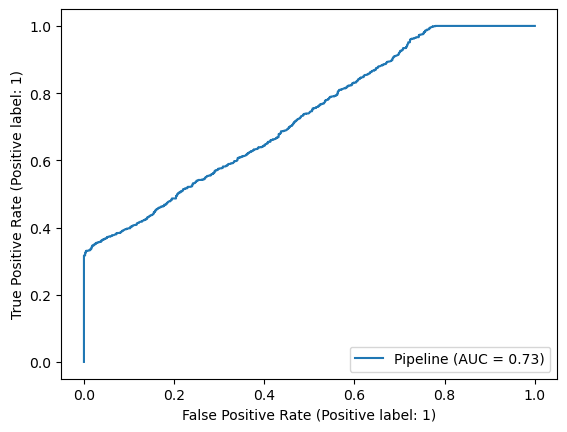

In [730]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)

# Calculate the confusion matrix






print(f'Accuracy score for log_reg fd is {clf.score(X_test, y_test)}')



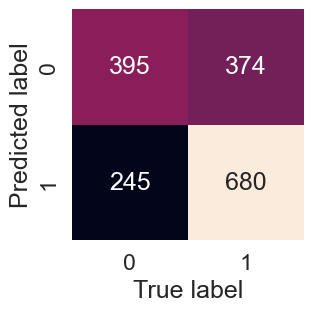

In [735]:
sns.set(font_scale=1.5)

def plot_conf_mat(y_test, y_preds):
    """
    Plots a confusion matrix using seaborn's heatmap
    """
    
    fig, ax = plt.subplots(figsize=(3,3))
    ax = sns.heatmap(confusion_matrix(y_test, y_preds ),
                    annot=True,
                    cbar=False,
                    fmt='.0f')
    plt.xlabel('True label')
    plt.ylabel('Predicted label')
    
plot_conf_mat(y_test, y_preds)

In [738]:
# Calculate the classification report 
print(classification_report(y_test, y_preds))

              precision    recall  f1-score   support

           0       0.62      0.51      0.56       769
           1       0.65      0.74      0.69       925

    accuracy                           0.63      1694
   macro avg       0.63      0.62      0.62      1694
weighted avg       0.63      0.63      0.63      1694



In [743]:
# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

0.5575563940972307

In [744]:
# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

0.5739249185726835

In [745]:
# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

0.6367994775954493

In [748]:
# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

0.5991341485483578

<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_fd)'}>

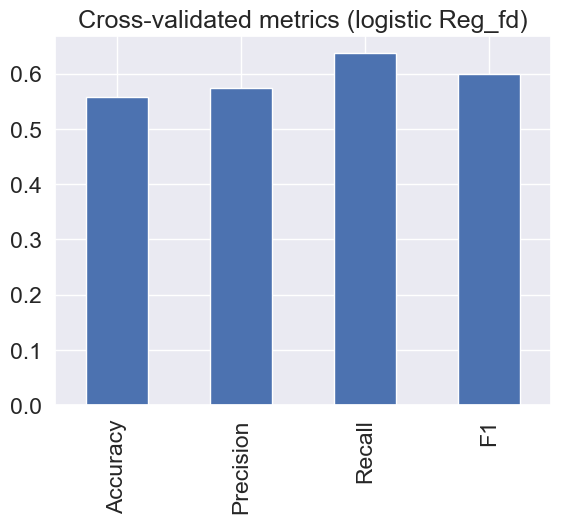

In [752]:
# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_fd)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg fd is 0.6345926800472255
              precision    recall  f1-score   support

           0       0.62      0.51      0.56       769
           1       0.65      0.74      0.69       925

    accuracy                           0.63      1694
   macro avg       0.63      0.62      0.62      1694
weighted avg       0.63      0.63      0.63      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_fd)'}>

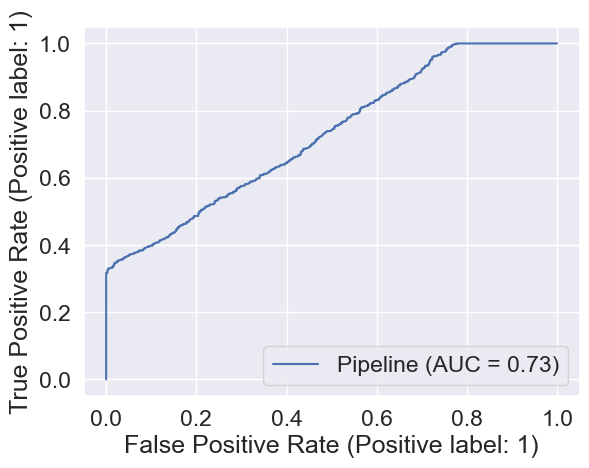

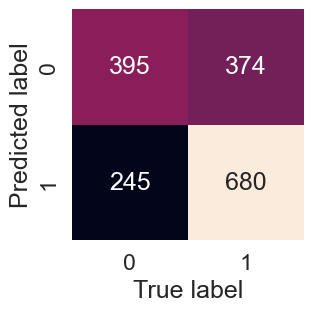

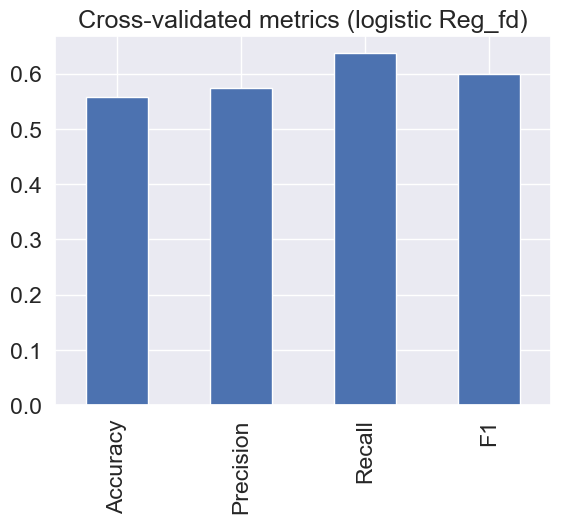

In [768]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg fd is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_fd)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg m1d is 0.6263282172373081
              precision    recall  f1-score   support

           0       0.60      0.52      0.56       769
           1       0.64      0.72      0.68       925

    accuracy                           0.63      1694
   macro avg       0.62      0.62      0.62      1694
weighted avg       0.62      0.63      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_m1d)'}>

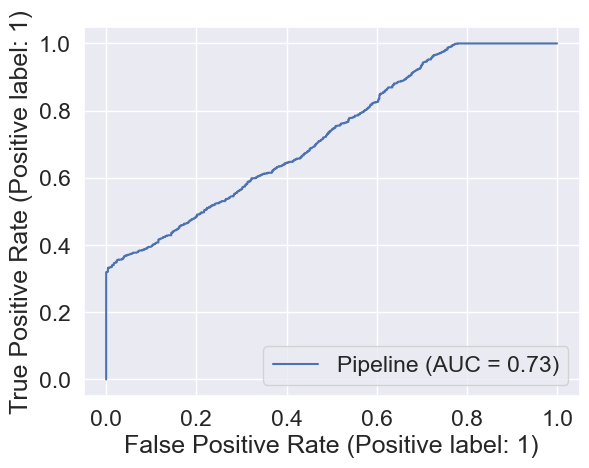

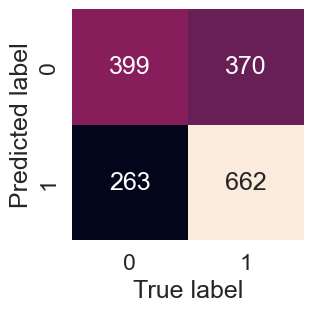

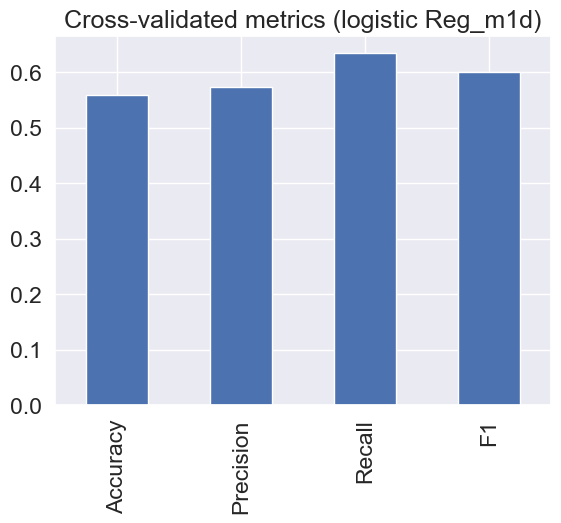

In [766]:
# Run for 'm1d' data:

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])
    
    
X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg m1d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_m1d)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg m2d is 0.6245572609208973
              precision    recall  f1-score   support

           0       0.60      0.51      0.55       769
           1       0.64      0.72      0.68       925

    accuracy                           0.62      1694
   macro avg       0.62      0.61      0.61      1694
weighted avg       0.62      0.62      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_m2d)'}>

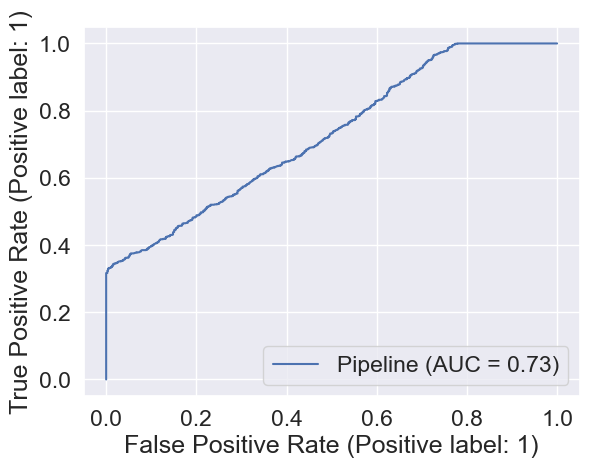

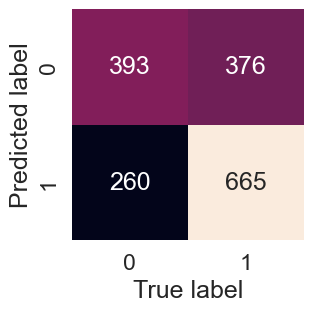

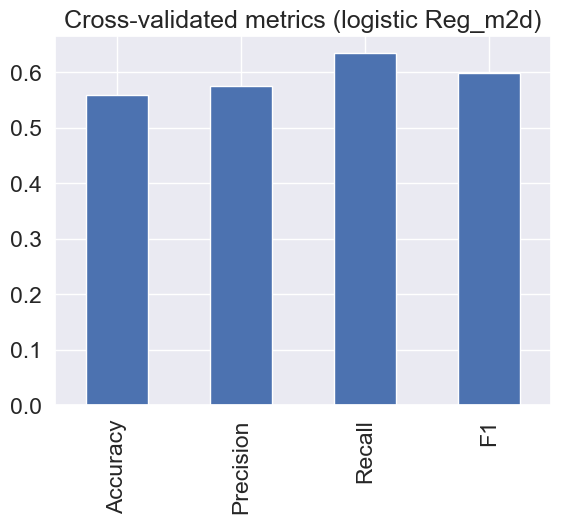

In [767]:

# Run for 'm2d' data:

# Define preprocessors


# pipeline for categorical data


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg m2d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_m2d)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg m3d is 0.6286894923258559
              precision    recall  f1-score   support

           0       0.61      0.50      0.55       769
           1       0.64      0.73      0.68       925

    accuracy                           0.63      1694
   macro avg       0.63      0.62      0.62      1694
weighted avg       0.63      0.63      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_m3d)'}>

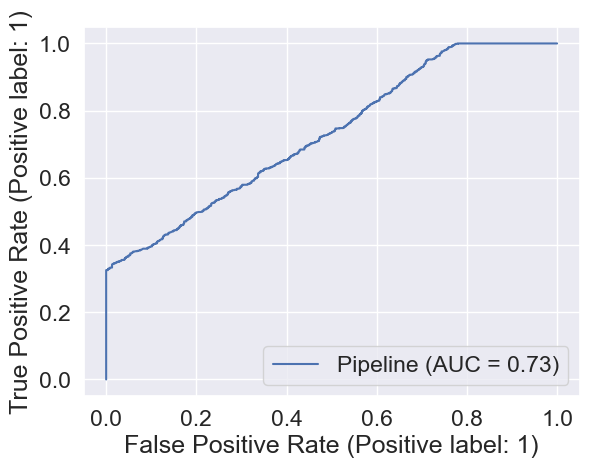

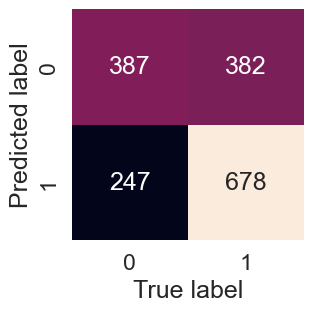

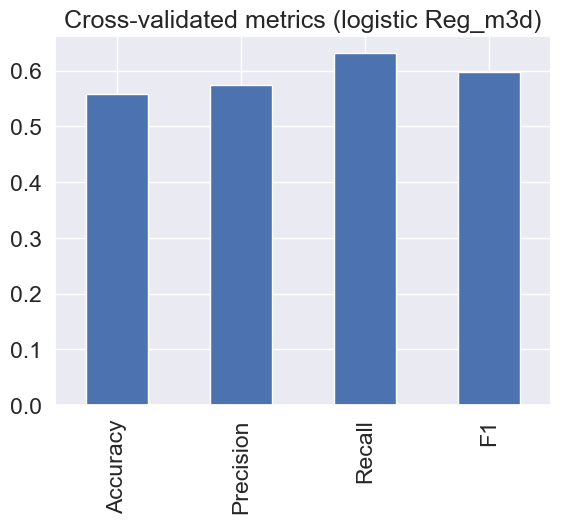

In [769]:

# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])



X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg m3d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_m3d)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg nog is 0.6345926800472255
              precision    recall  f1-score   support

           0       0.61      0.52      0.57       769
           1       0.65      0.73      0.68       925

    accuracy                           0.63      1694
   macro avg       0.63      0.63      0.63      1694
weighted avg       0.63      0.63      0.63      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_nog)'}>

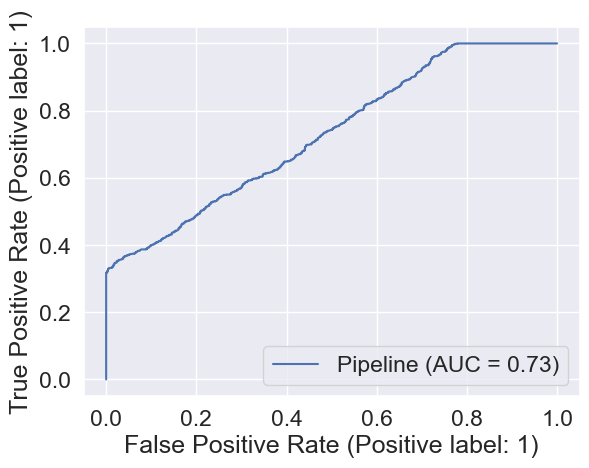

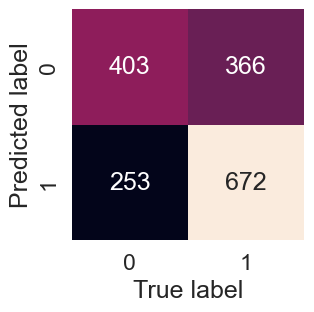

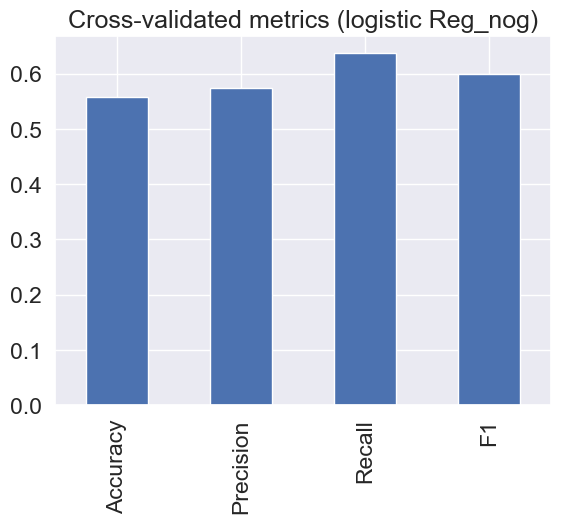

In [770]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])

X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg nog is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_nog)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg num is 0.5826446280991735
              precision    recall  f1-score   support

           0       0.54      0.51      0.53       769
           1       0.61      0.64      0.63       925

    accuracy                           0.58      1694
   macro avg       0.58      0.58      0.58      1694
weighted avg       0.58      0.58      0.58      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_num)'}>

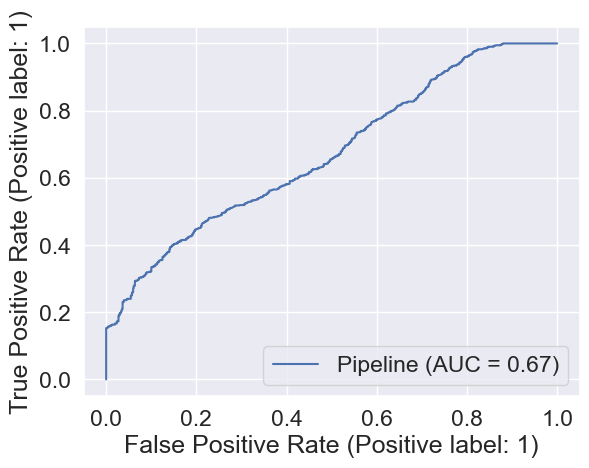

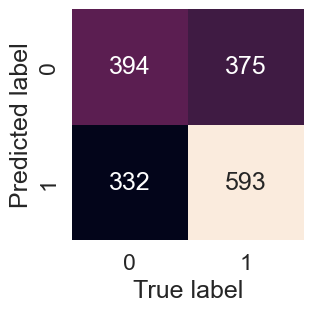

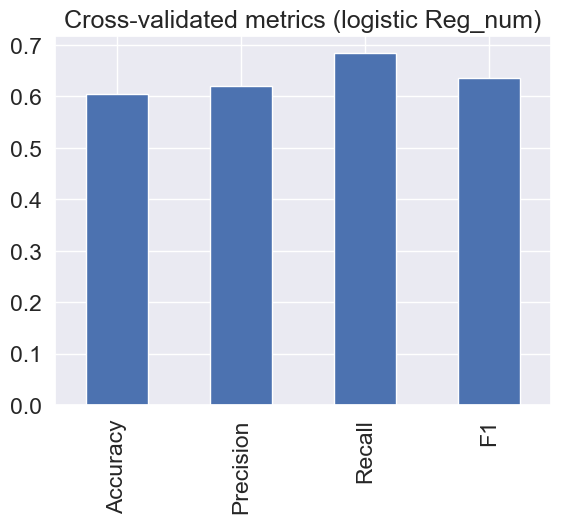

In [772]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg num is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_num)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg ned is 0.6316410861865407
              precision    recall  f1-score   support

           0       0.61      0.54      0.57       769
           1       0.65      0.71      0.68       925

    accuracy                           0.63      1694
   macro avg       0.63      0.62      0.62      1694
weighted avg       0.63      0.63      0.63      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_ned)'}>

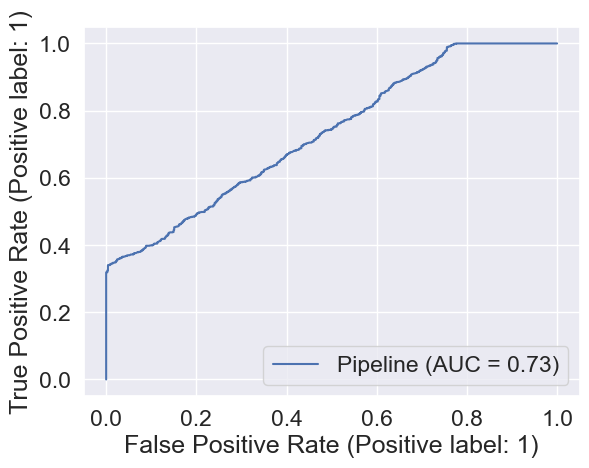

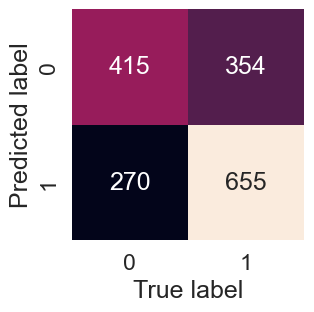

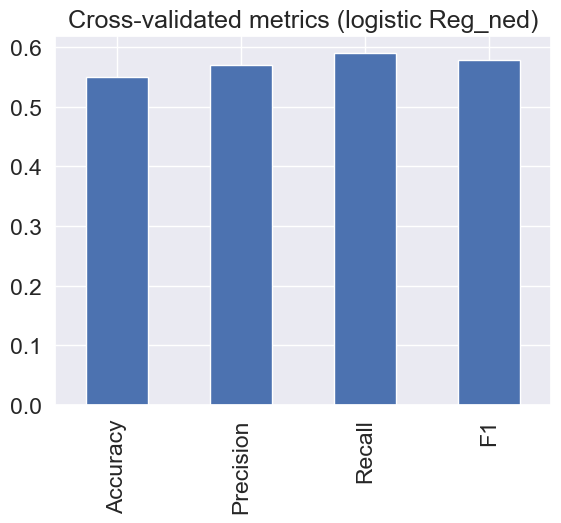

In [773]:
# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg ned is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_ned)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg sed is 0.6322314049586777
              precision    recall  f1-score   support

           0       0.61      0.54      0.57       769
           1       0.65      0.70      0.68       925

    accuracy                           0.63      1694
   macro avg       0.63      0.62      0.63      1694
weighted avg       0.63      0.63      0.63      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_sed)'}>

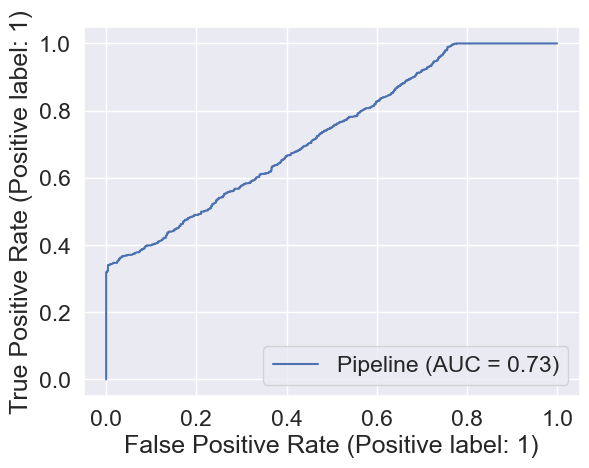

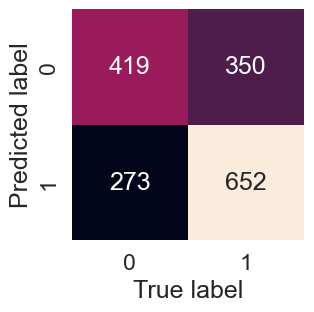

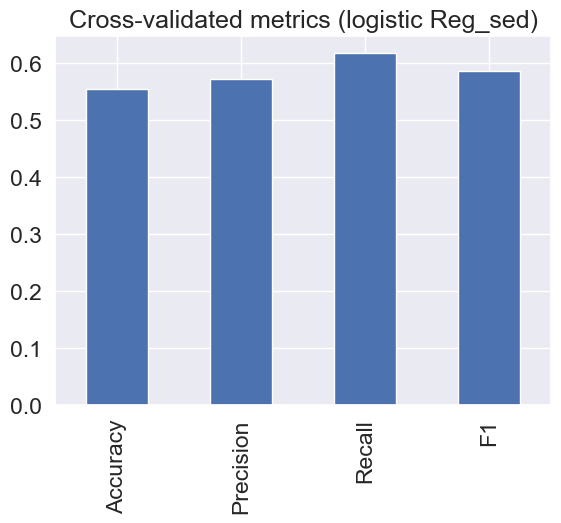

In [775]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg sed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_sed)', legend=False)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



Accuracy score for log_reg fed is 0.6375442739079102
              precision    recall  f1-score   support

           0       0.62      0.51      0.56       769
           1       0.65      0.74      0.69       925

    accuracy                           0.64      1694
   macro avg       0.63      0.63      0.63      1694
weighted avg       0.64      0.64      0.63      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_fed)'}>

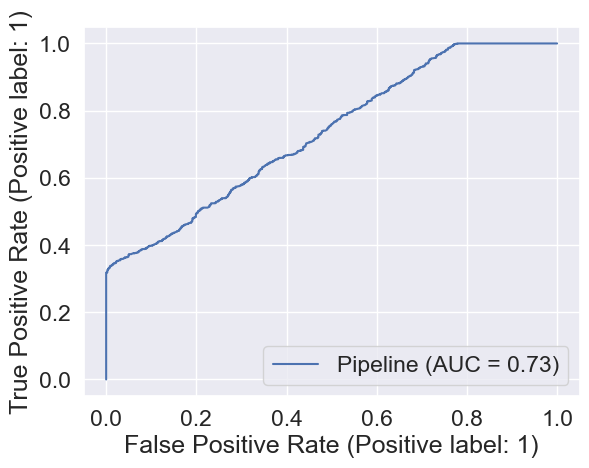

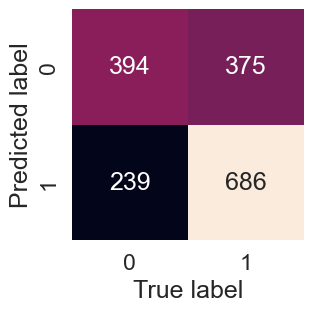

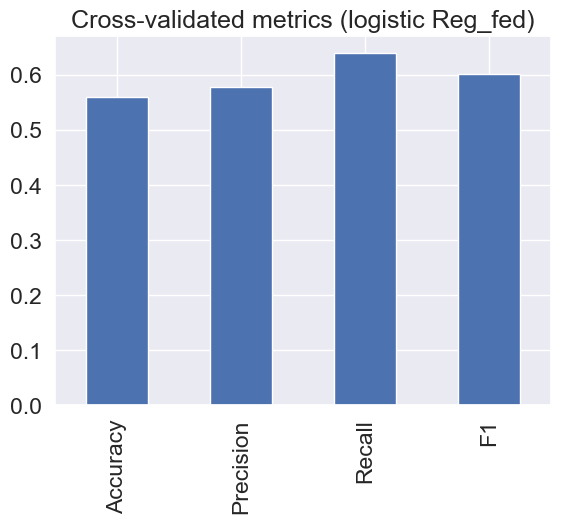

In [774]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

plot_roc_curve(clf, X_test, y_test)



print(f'Accuracy score for log_reg fed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_fed)', legend=False)

## SVM

Accuracy score for SVC fd is 0.6227863046044865
              precision    recall  f1-score   support

           0       0.61      0.48      0.54       769
           1       0.63      0.74      0.68       925

    accuracy                           0.62      1694
   macro avg       0.62      0.61      0.61      1694
weighted avg       0.62      0.62      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_fd)'}>

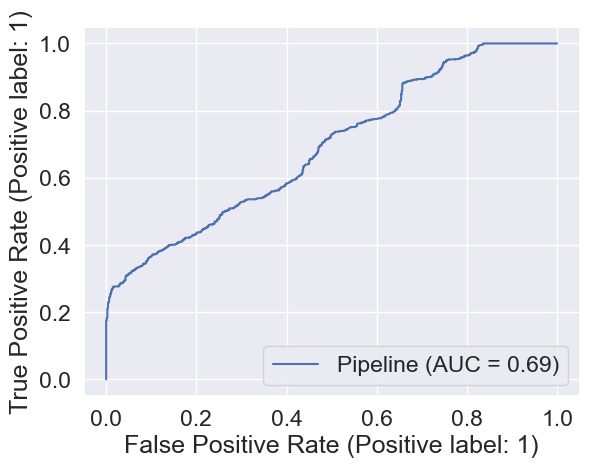

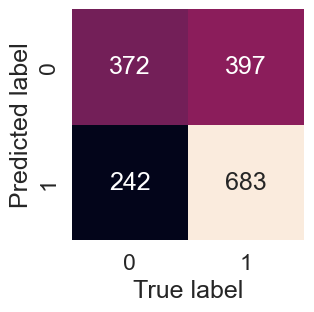

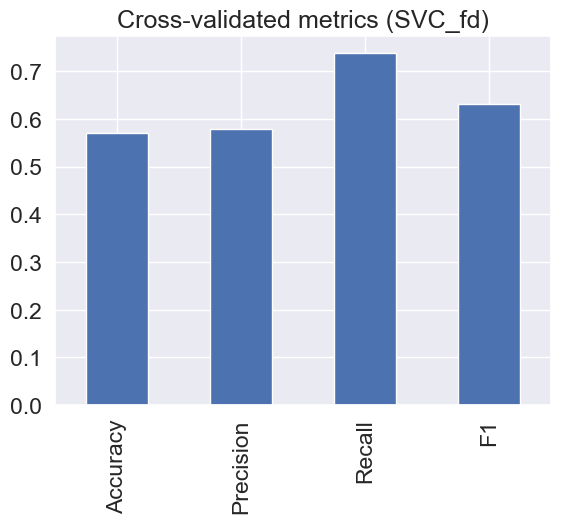

In [779]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC fd is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_fd)', legend=False)

Accuracy score for SVC m1d is 0.6257378984651711
              precision    recall  f1-score   support

           0       0.61      0.49      0.54       769
           1       0.64      0.74      0.68       925

    accuracy                           0.63      1694
   macro avg       0.62      0.61      0.61      1694
weighted avg       0.62      0.63      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_m1d)'}>

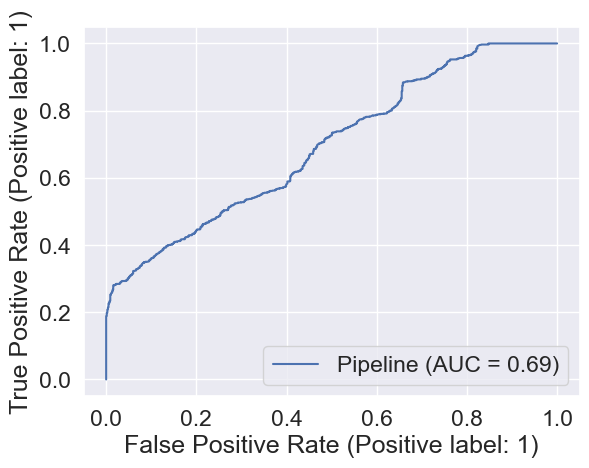

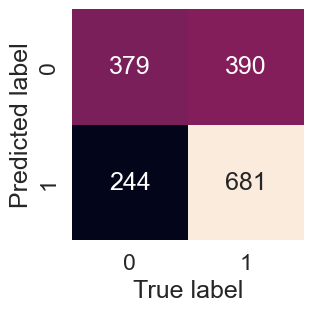

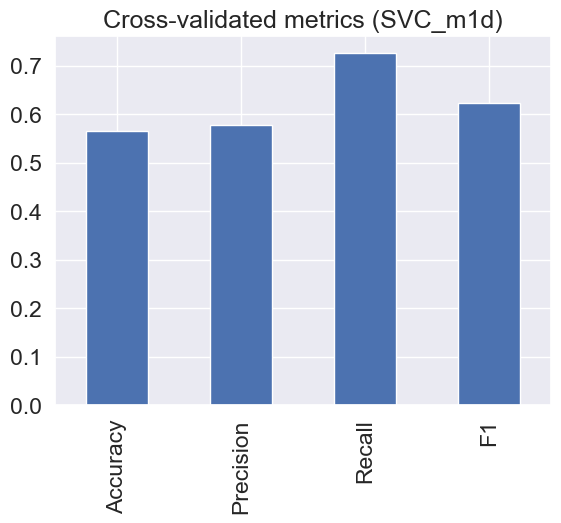

In [780]:
# Run for 'm1d' data:

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])
    
    
X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC m1d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_m1d)', legend=False)

Accuracy score for SVC m2d is 0.6233766233766234
              precision    recall  f1-score   support

           0       0.60      0.49      0.54       769
           1       0.63      0.73      0.68       925

    accuracy                           0.62      1694
   macro avg       0.62      0.61      0.61      1694
weighted avg       0.62      0.62      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_m2d)'}>

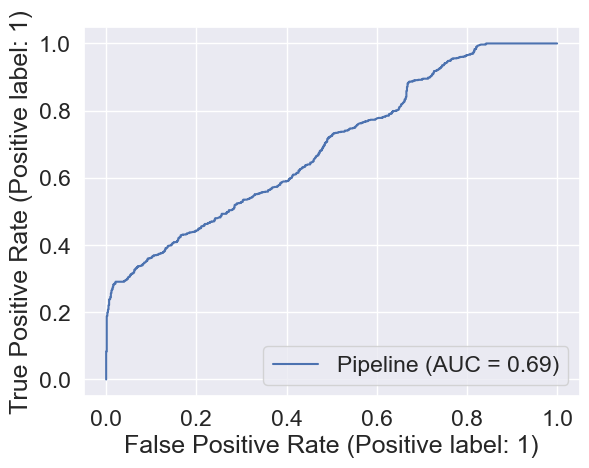

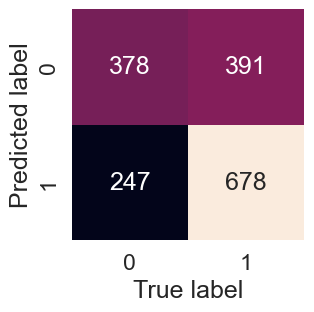

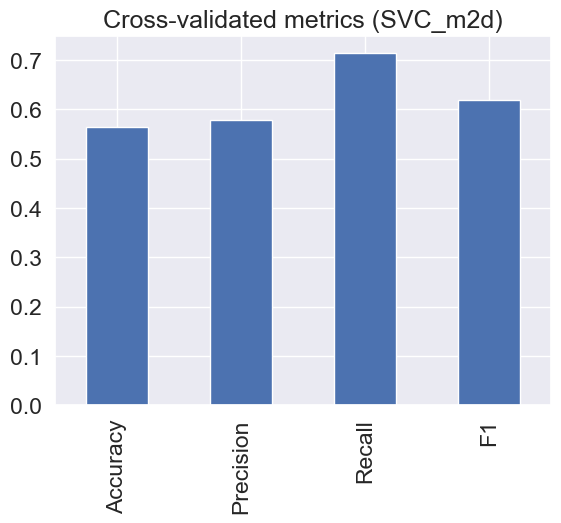

In [781]:

# Run for 'm2d' data:

# Define preprocessors


# pipeline for categorical data


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC m2d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_m2d)', legend=False)

Accuracy score for SVC m3d is 0.6210153482880756
              precision    recall  f1-score   support

           0       0.59      0.53      0.56       769
           1       0.64      0.69      0.67       925

    accuracy                           0.62      1694
   macro avg       0.62      0.61      0.61      1694
weighted avg       0.62      0.62      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_m3d)'}>

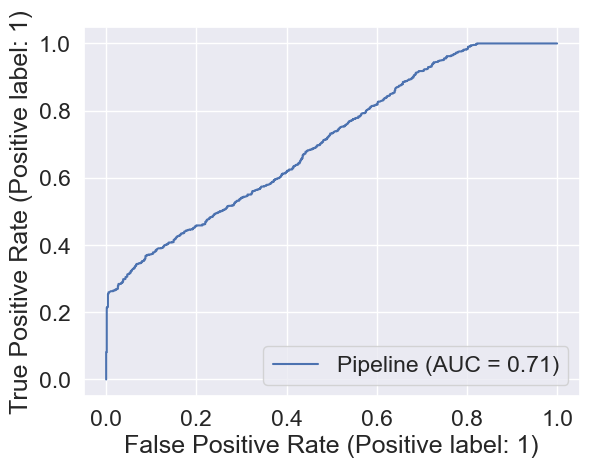

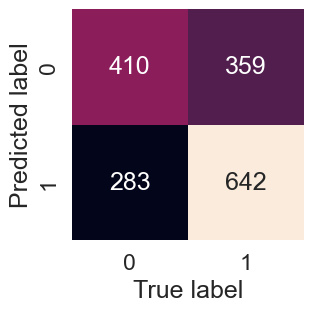

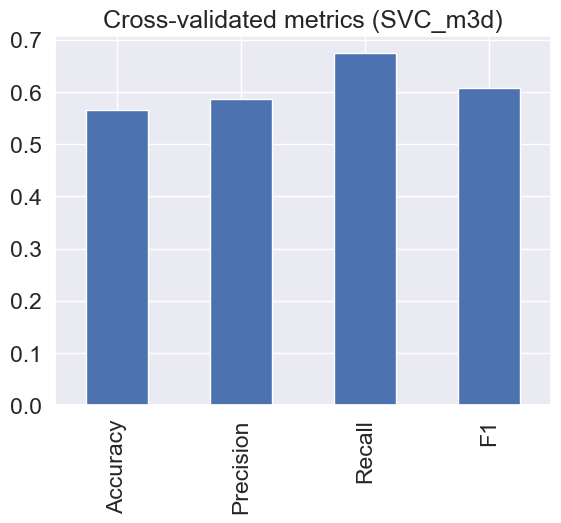

In [782]:

# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])



X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC m3d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_m3d)', legend=False)

Accuracy score for SVC nog is 0.6221959858323495
              precision    recall  f1-score   support

           0       0.60      0.48      0.54       769
           1       0.63      0.74      0.68       925

    accuracy                           0.62      1694
   macro avg       0.62      0.61      0.61      1694
weighted avg       0.62      0.62      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_nog)'}>

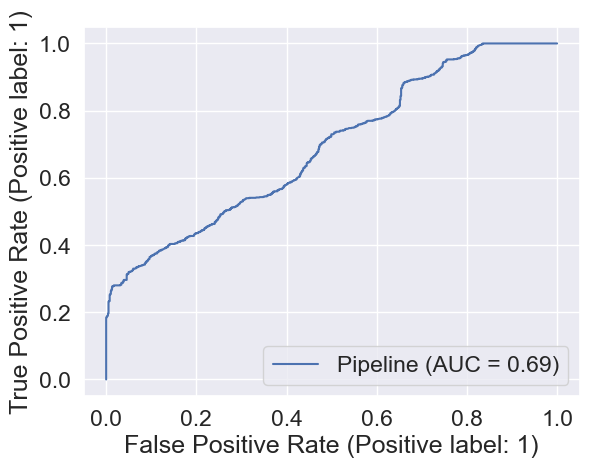

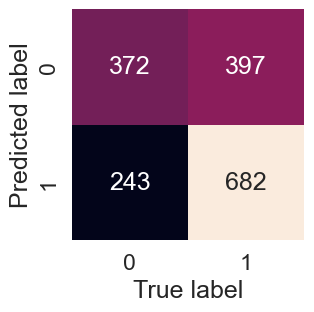

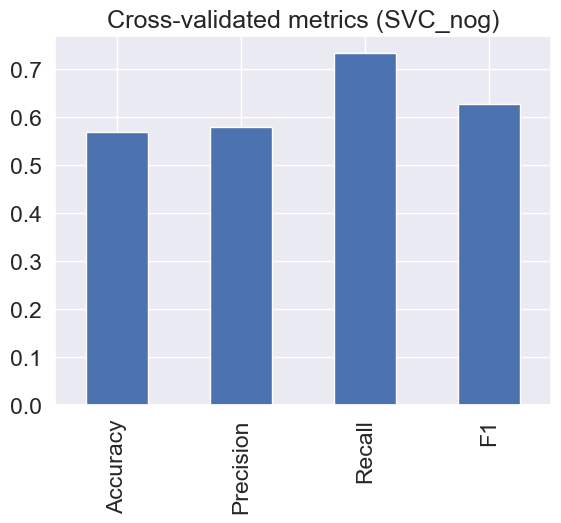

In [783]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])

X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC nog is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_nog)', legend=False)

Accuracy score for SVC num is 0.6103896103896104
              precision    recall  f1-score   support

           0       0.57      0.58      0.58       769
           1       0.65      0.63      0.64       925

    accuracy                           0.61      1694
   macro avg       0.61      0.61      0.61      1694
weighted avg       0.61      0.61      0.61      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_num)'}>

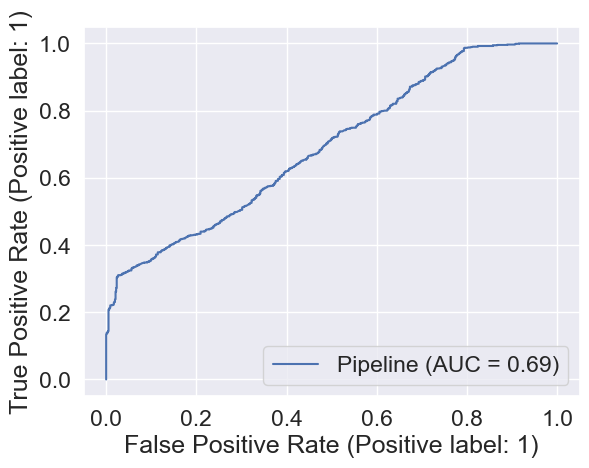

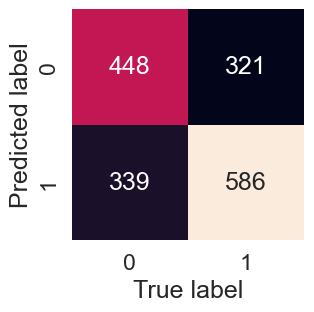

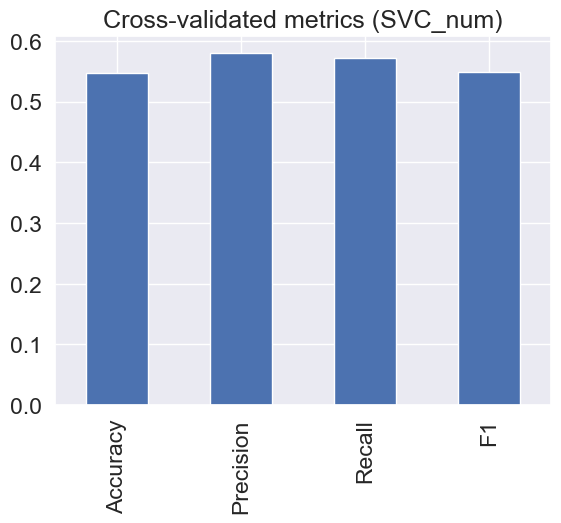

In [784]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=1, degree=0))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC num is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_num)', legend=False)

Accuracy score for SVC ned is 0.6044864226682408
              precision    recall  f1-score   support

           0       0.59      0.41      0.49       769
           1       0.61      0.76      0.68       925

    accuracy                           0.60      1694
   macro avg       0.60      0.59      0.58      1694
weighted avg       0.60      0.60      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_ned)'}>

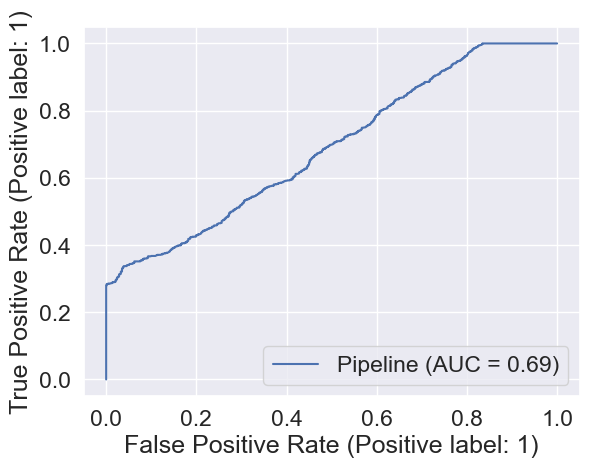

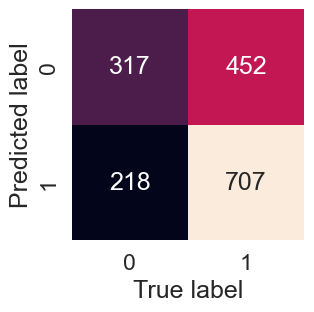

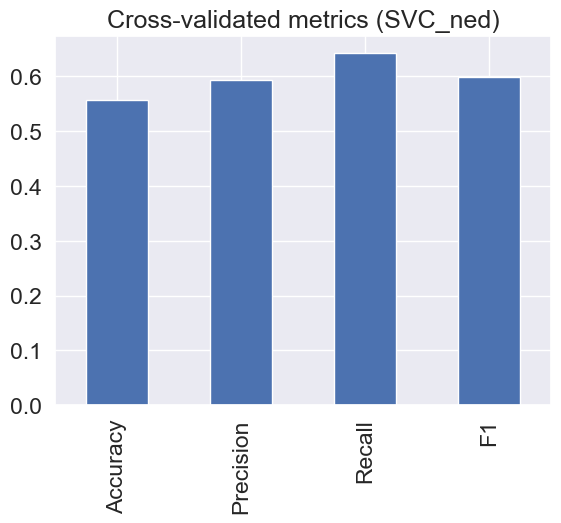

In [785]:
# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC ned is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_ned)', legend=False)

Accuracy score for SVC sed is 0.628099173553719
              precision    recall  f1-score   support

           0       0.66      0.38      0.48       769
           1       0.62      0.83      0.71       925

    accuracy                           0.63      1694
   macro avg       0.64      0.61      0.60      1694
weighted avg       0.64      0.63      0.61      1694



<AxesSubplot:title={'center':'Cross-validated metrics (SVC_sed)'}>

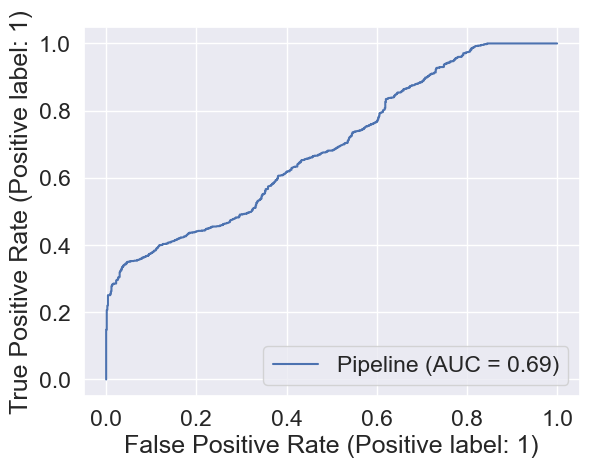

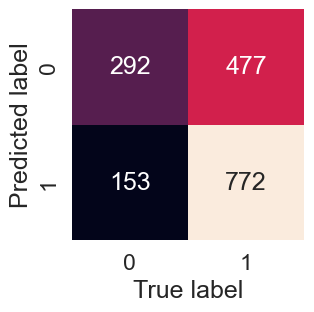

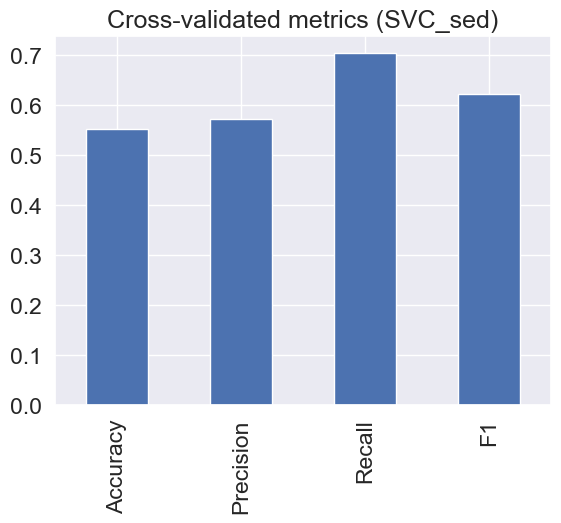

In [786]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC sed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (SVC_sed)', legend=False)

Accuracy score for SVC fed is 0.628099173553719
              precision    recall  f1-score   support

           0       0.61      0.49      0.54       769
           1       0.64      0.75      0.69       925

    accuracy                           0.63      1694
   macro avg       0.63      0.62      0.61      1694
weighted avg       0.63      0.63      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic Reg_fed)'}>

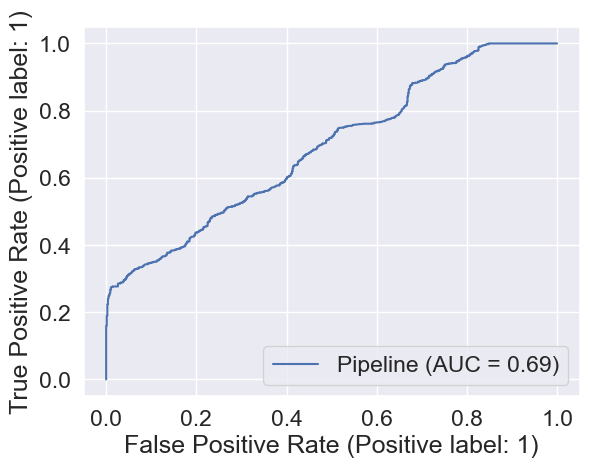

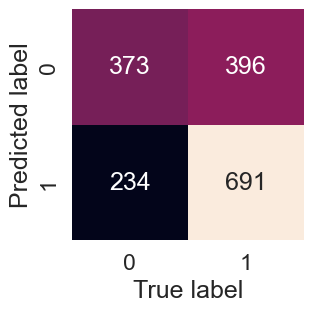

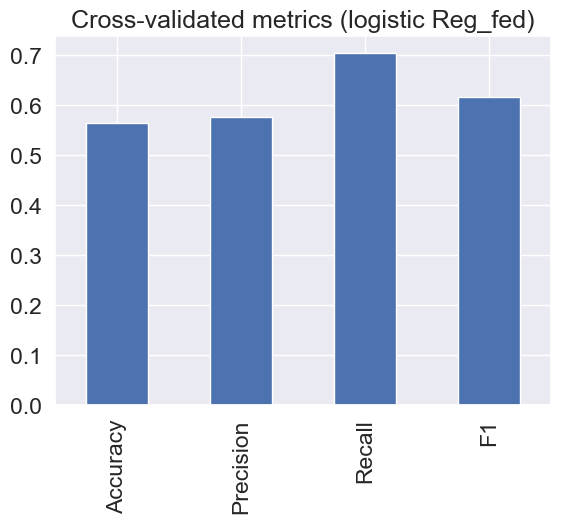

In [787]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", SVC(C=0.1))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for SVC fed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic Reg_fed)', legend=False)

## Random Forest

Accuracy score for rf_fd is 0.6528925619834711
              precision    recall  f1-score   support

           0       0.99      0.24      0.38       769
           1       0.61      1.00      0.76       925

    accuracy                           0.65      1694
   macro avg       0.80      0.62      0.57      1694
weighted avg       0.79      0.65      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_fd)'}>

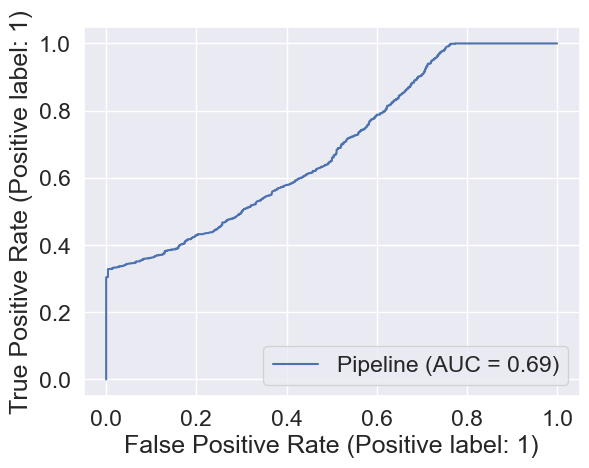

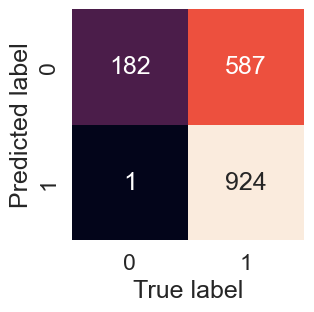

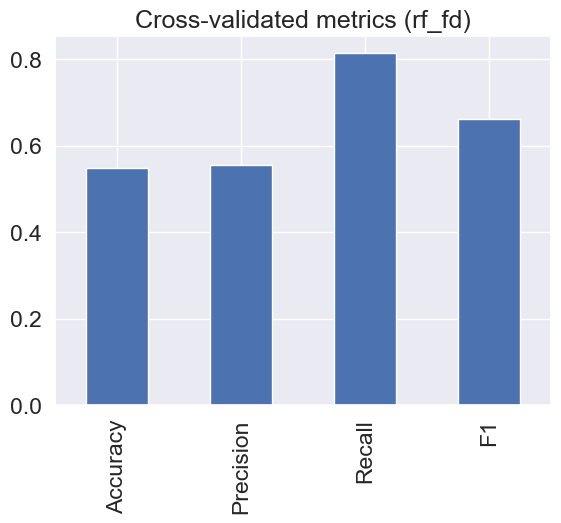

In [788]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=10, min_samples_leaf=3,
                                        min_samples_split=16,
                                        n_estimators=710))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_fd is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_fd)', legend=False)

Accuracy score for rf_m1d is 0.6517119244391971
              precision    recall  f1-score   support

           0       0.98      0.24      0.38       769
           1       0.61      1.00      0.76       925

    accuracy                           0.65      1694
   macro avg       0.80      0.62      0.57      1694
weighted avg       0.78      0.65      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_m1d)'}>

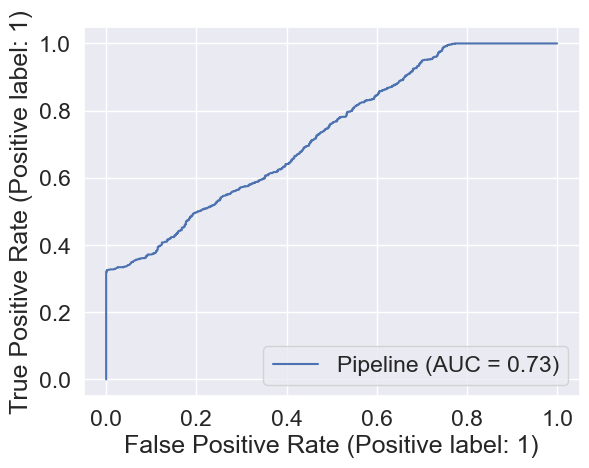

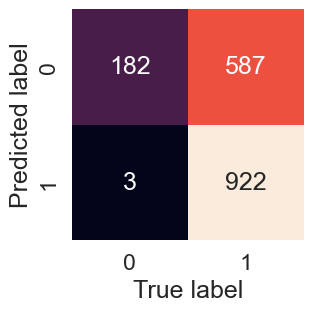

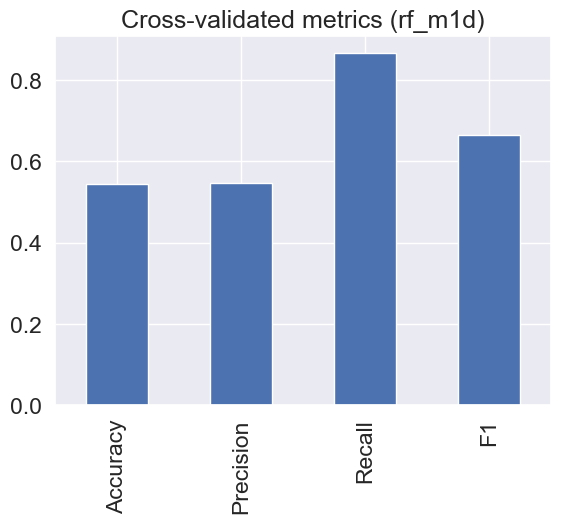

In [789]:
# Run for 'm1d' data:

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])
    
    
X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf",  RandomForestClassifier(max_depth=5, min_samples_split=18,
                                        n_estimators=610))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_m1d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_m1d)', legend=False)

Accuracy score for rf_SVC m2d is 0.6511216056670602
              precision    recall  f1-score   support

           0       0.98      0.24      0.38       769
           1       0.61      1.00      0.76       925

    accuracy                           0.65      1694
   macro avg       0.80      0.62      0.57      1694
weighted avg       0.78      0.65      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_m2d)'}>

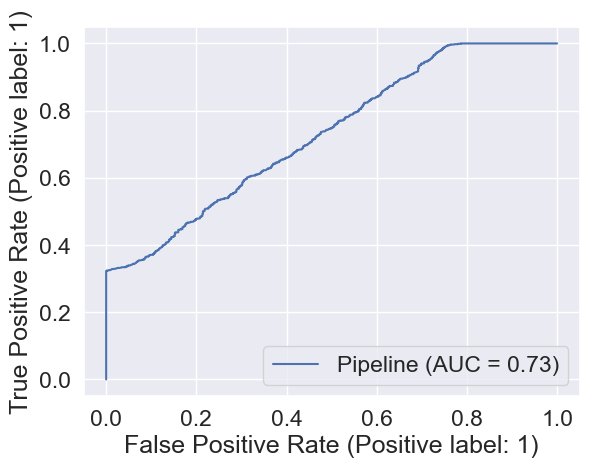

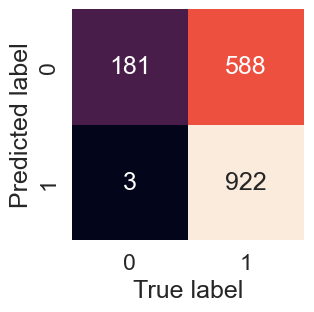

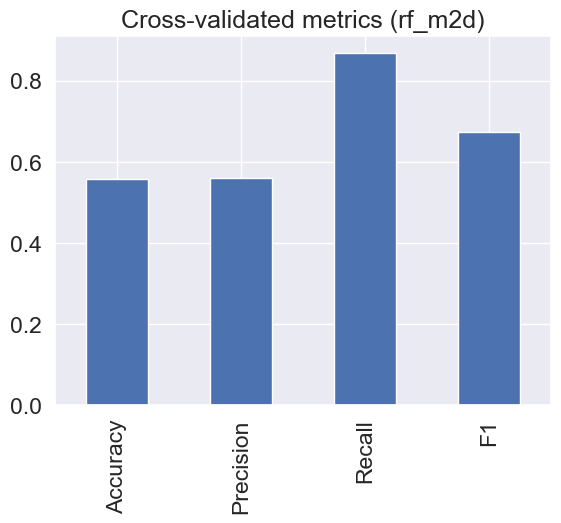

In [790]:

# Run for 'm2d' data:

# Define preprocessors


# pipeline for categorical data


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=5, min_samples_split=18,
                                        n_estimators=610))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_SVC m2d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_m2d)', legend=False)

Accuracy score for rf_m3d is 0.6523022432113341
              precision    recall  f1-score   support

           0       0.76      0.34      0.47       769
           1       0.62      0.91      0.74       925

    accuracy                           0.65      1694
   macro avg       0.69      0.63      0.61      1694
weighted avg       0.69      0.65      0.62      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_m3d)'}>

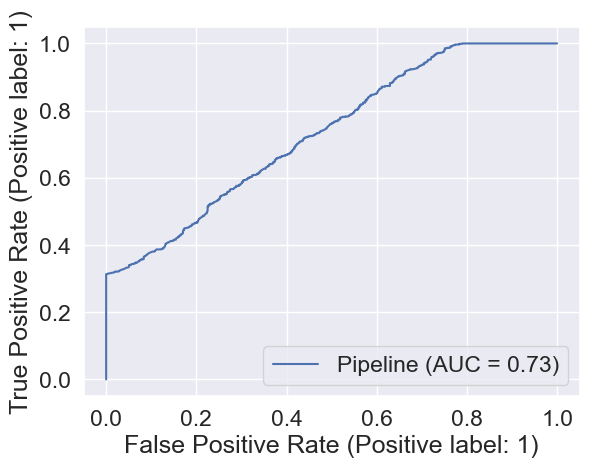

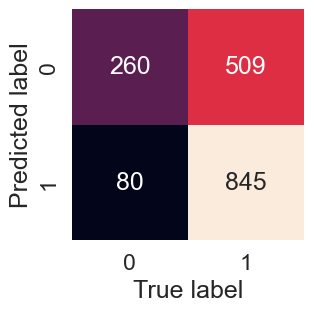

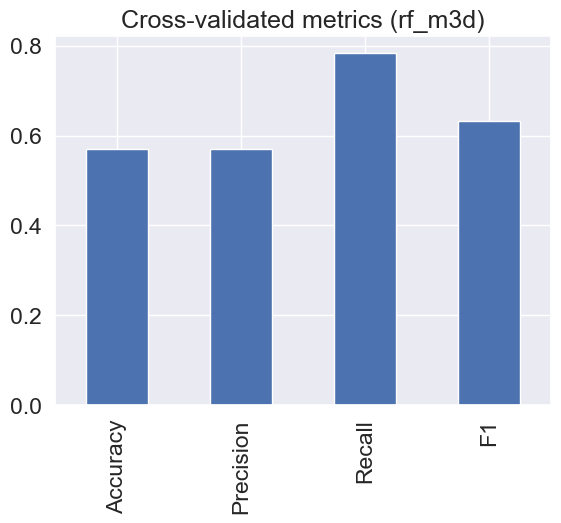

In [791]:

# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])



X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=5, min_samples_split=18,
                                        n_estimators=610))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_m3d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_m3d)', legend=False)

Accuracy score for rf_nog is 0.6523022432113341
              precision    recall  f1-score   support

           0       0.98      0.24      0.38       769
           1       0.61      1.00      0.76       925

    accuracy                           0.65      1694
   macro avg       0.80      0.62      0.57      1694
weighted avg       0.78      0.65      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_nog)'}>

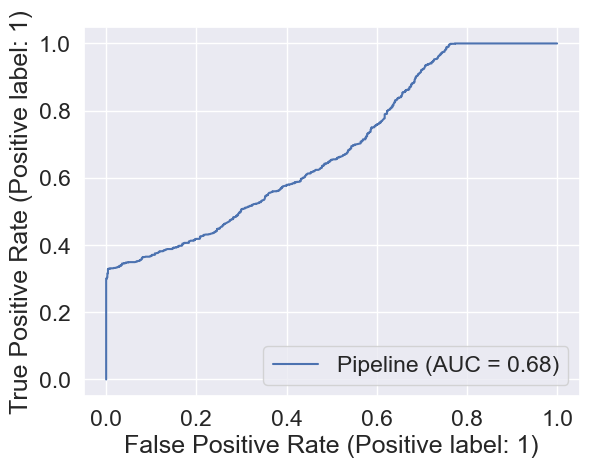

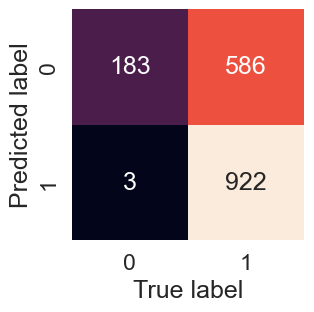

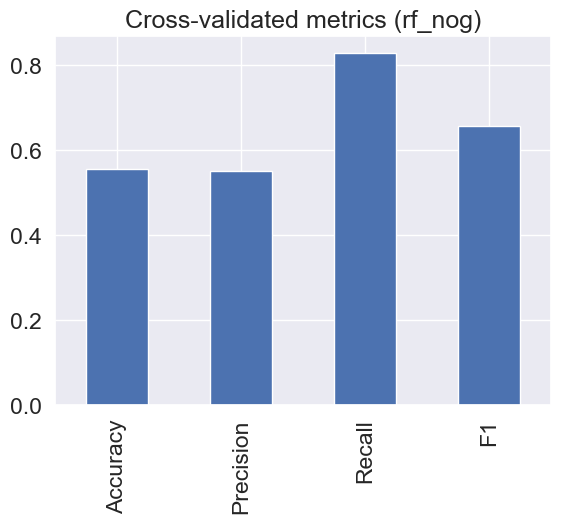

In [792]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])

X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=10, min_samples_leaf=3,
                                        min_samples_split=16,
                                        n_estimators=710))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_nog is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_nog)', legend=False)

Accuracy score for rf_num is 0.6357733175914995
              precision    recall  f1-score   support

           0       0.71      0.33      0.45       769
           1       0.62      0.89      0.73       925

    accuracy                           0.64      1694
   macro avg       0.66      0.61      0.59      1694
weighted avg       0.66      0.64      0.60      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_num)'}>

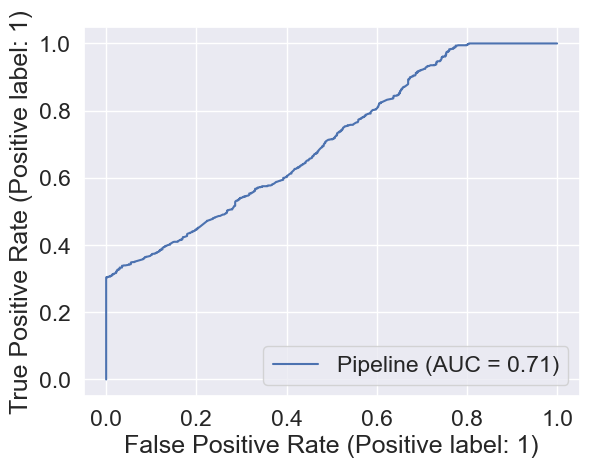

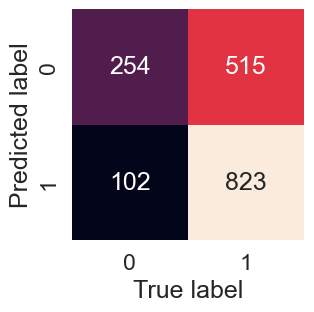

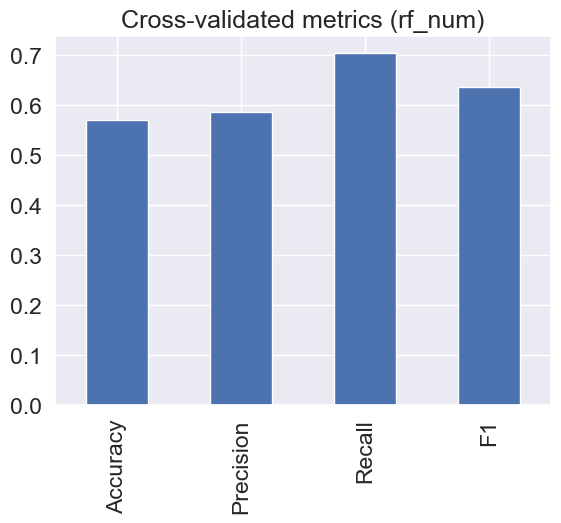

In [793]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=3, min_samples_leaf=7,
                                        min_samples_split=6,
                                        n_estimators=560))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_num is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_num)', legend=False)

Accuracy score for rf_ned is 0.6517119244391971
              precision    recall  f1-score   support

           0       1.00      0.23      0.38       769
           1       0.61      1.00      0.76       925

    accuracy                           0.65      1694
   macro avg       0.81      0.62      0.57      1694
weighted avg       0.79      0.65      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_ned)'}>

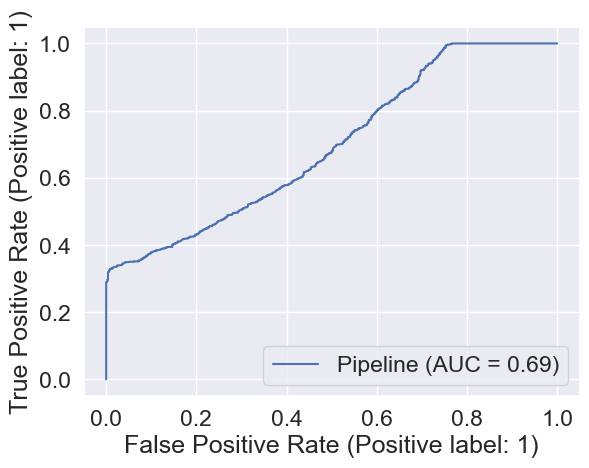

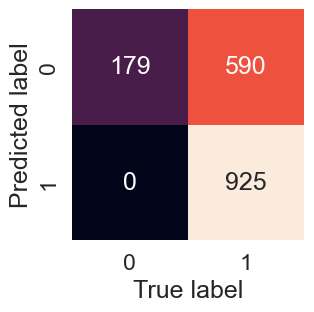

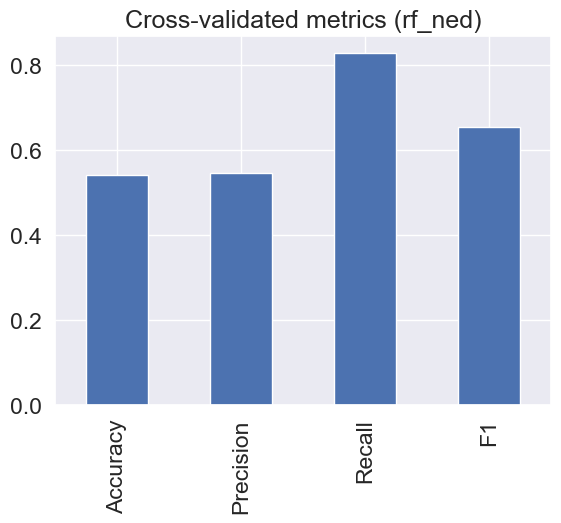

In [794]:
# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=10, min_samples_leaf=3,
                                        min_samples_split=16,
                                        n_estimators=710))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_ned is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_ned)', legend=False)

Accuracy score for rf_sed is 0.6493506493506493
              precision    recall  f1-score   support

           0       0.97      0.24      0.38       769
           1       0.61      0.99      0.76       925

    accuracy                           0.65      1694
   macro avg       0.79      0.61      0.57      1694
weighted avg       0.77      0.65      0.58      1694



<AxesSubplot:title={'center':'Cross-validated metrics (rf_sed)'}>

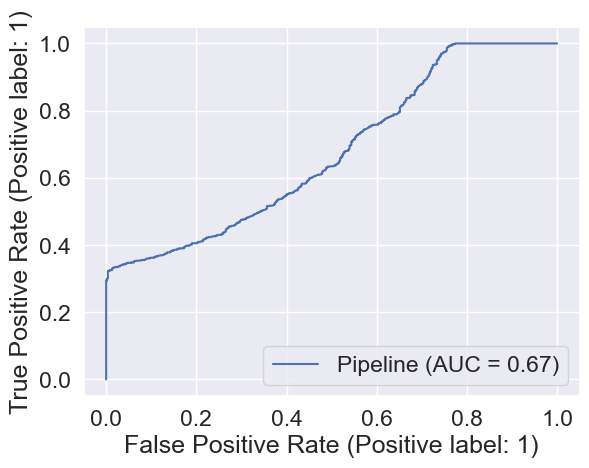

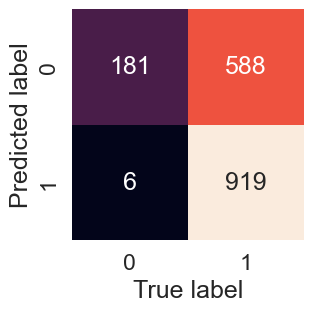

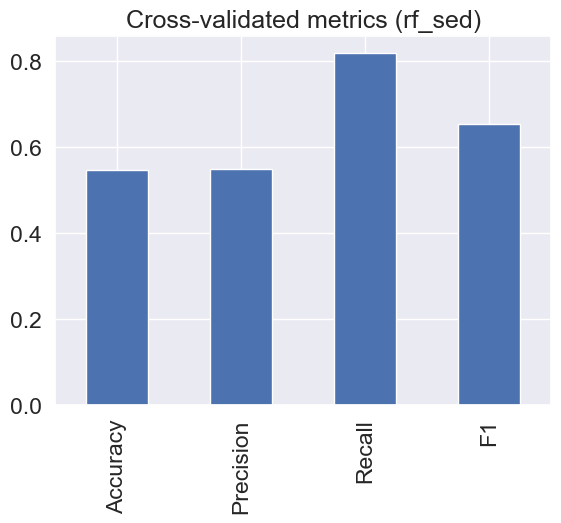

In [795]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf",RandomForestClassifier(max_depth=10, min_samples_split=18,
                                        n_estimators=910))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_sed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (rf_sed)', legend=False)

Accuracy score for rf_fed is 0.6528925619834711
              precision    recall  f1-score   support

           0       0.98      0.24      0.39       769
           1       0.61      1.00      0.76       925

    accuracy                           0.65      1694
   macro avg       0.80      0.62      0.57      1694
weighted avg       0.78      0.65      0.59      1694



<AxesSubplot:title={'center':'Cross-validated metrics (logistic rf_fed)'}>

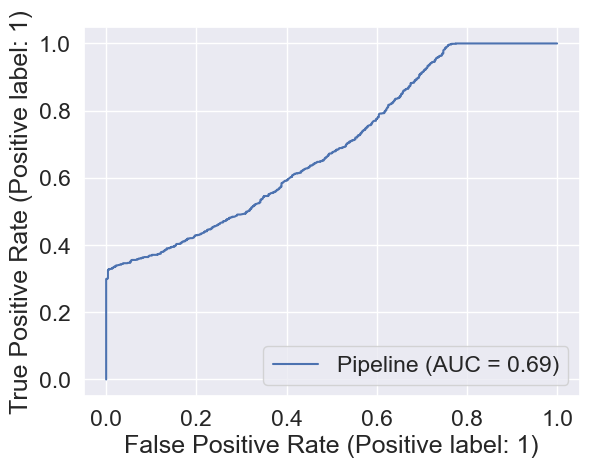

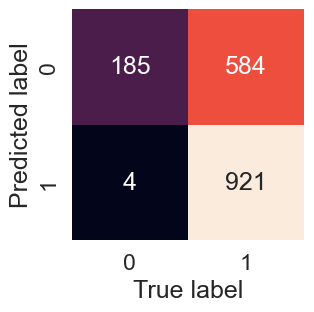

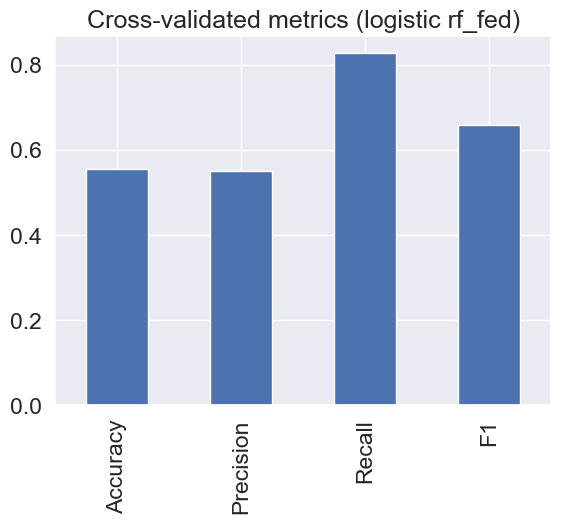

In [796]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean"))])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", RandomForestClassifier(max_depth=10, min_samples_leaf=3,
                                        min_samples_split=16,
                                        n_estimators=710))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for rf_fed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (logistic rf_fed)', legend=False)

## Naives Bayes

Accuracy score for NB_fd is 0.5850059031877214
              precision    recall  f1-score   support

           0       0.59      0.28      0.38       769
           1       0.58      0.84      0.69       925

    accuracy                           0.59      1694
   macro avg       0.59      0.56      0.53      1694
weighted avg       0.59      0.59      0.55      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_fd)'}>

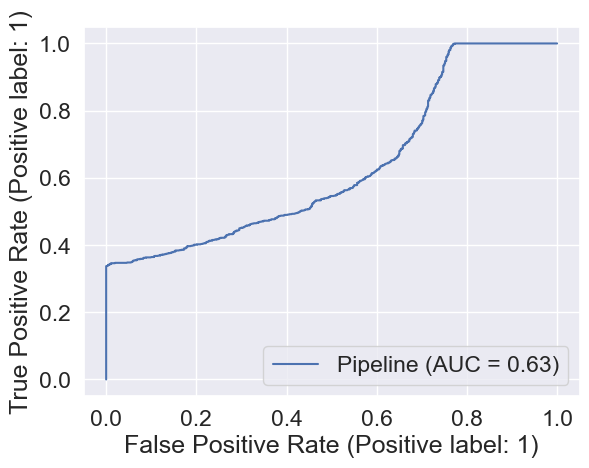

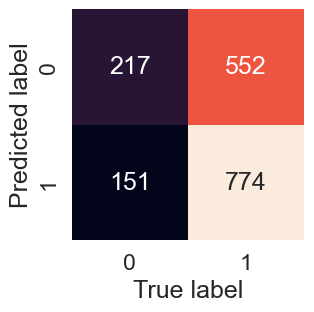

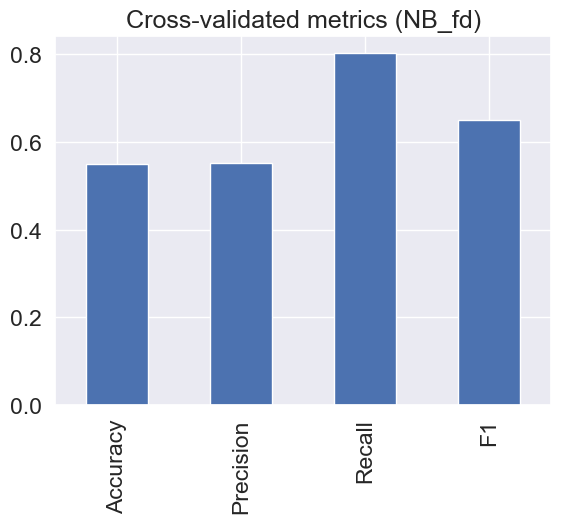

In [797]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=10))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_fd is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_fd)', legend=False)

Accuracy score for NB_m1d is 0.6056670602125147
              precision    recall  f1-score   support

           0       0.97      0.14      0.24       769
           1       0.58      1.00      0.73       925

    accuracy                           0.61      1694
   macro avg       0.78      0.57      0.49      1694
weighted avg       0.76      0.61      0.51      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_m1d)'}>

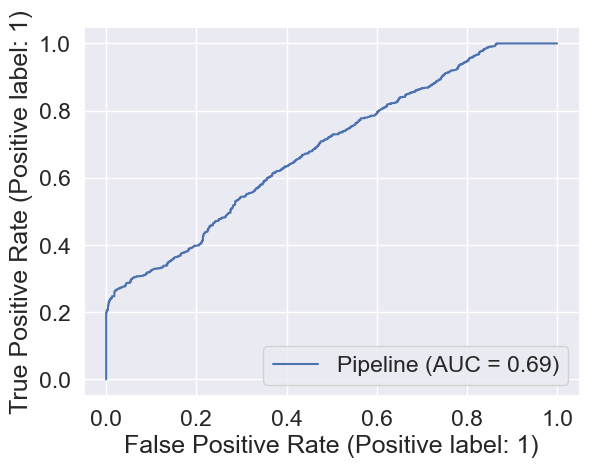

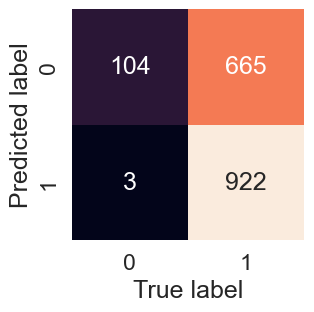

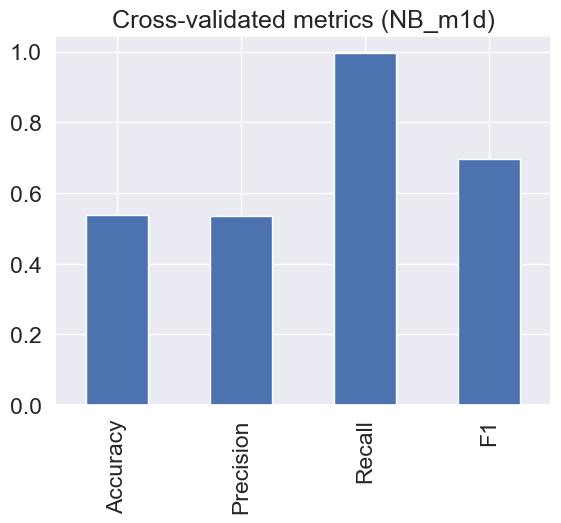

In [798]:
# Run for 'm1d' data:

# Define preprocessors


# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])
    
    
X = medium_1_data.drop('success',axis=1)
y = medium_1_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=1000, fit_prior=False))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_m1d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_m1d)', legend=False)

Accuracy score for NB_m2d is 0.6056670602125147
              precision    recall  f1-score   support

           0       0.99      0.13      0.23       769
           1       0.58      1.00      0.73       925

    accuracy                           0.61      1694
   macro avg       0.79      0.57      0.48      1694
weighted avg       0.77      0.61      0.51      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_m2d)'}>

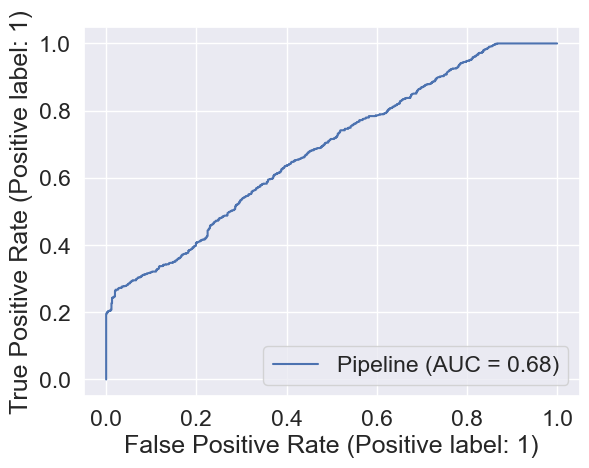

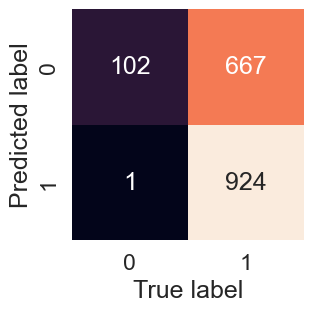

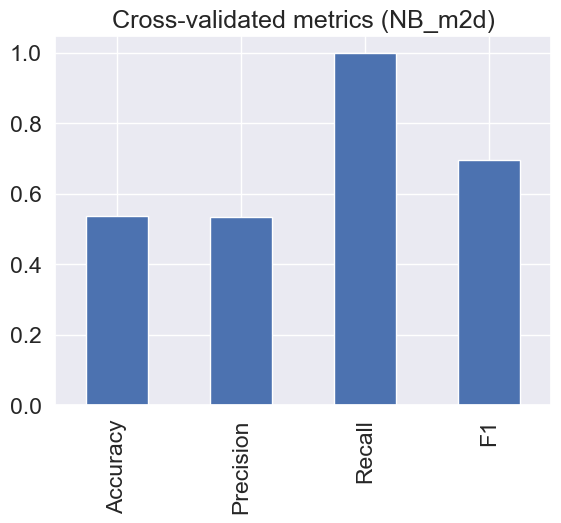

In [799]:

# Run for 'm2d' data:

# Define preprocessors


# pipeline for categorical data


# pipeline for categorical data

categorical_2_features = ['status','category_list','category_groups_list','uuid_p','gender',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_2_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat2", categorical_2_transformer, categorical_2_features),
])


X = medium_2_data.drop('success',axis=1)
y = medium_2_data['success']



# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=1000))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_m2d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_m2d)', legend=False)

Accuracy score for NB_m3d is 0.6469893742621016
              precision    recall  f1-score   support

           0       0.60      0.66      0.63       769
           1       0.69      0.63      0.66       925

    accuracy                           0.65      1694
   macro avg       0.65      0.65      0.65      1694
weighted avg       0.65      0.65      0.65      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_m3d)'}>

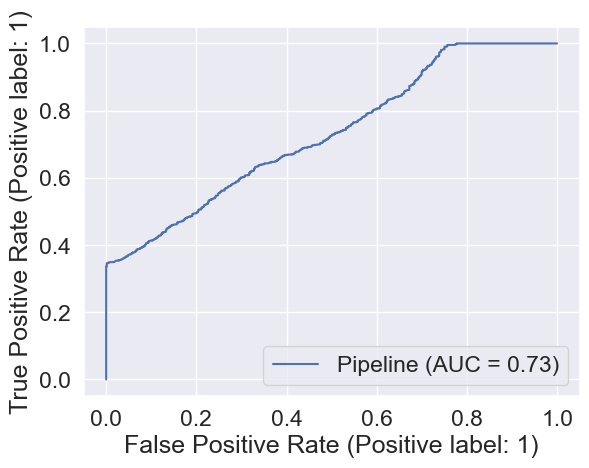

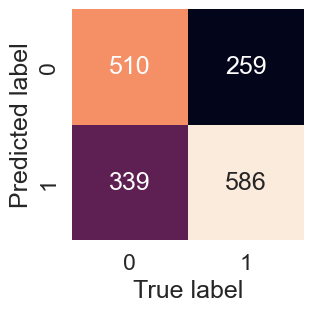

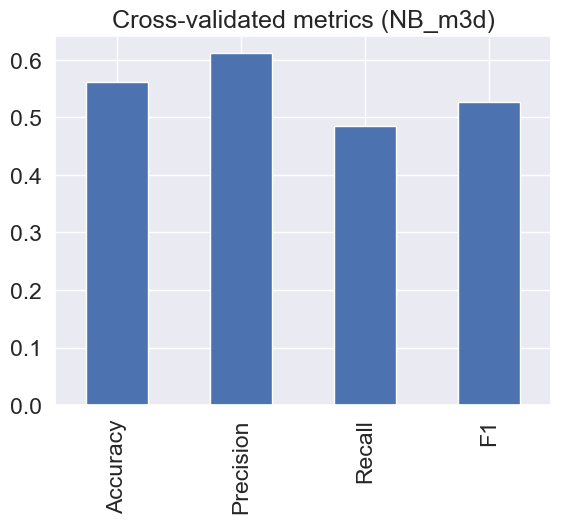

In [800]:

# Run for 'm3d' data:

# Define preprocessors


# pipeline for categorical data



# pipeline for categorical data

categorical_3_features = ['status','category_list','category_groups_list']

categorical_3_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
transformers=[
    ("num", numeric_transformer, numeric_features),
    ("cat3", categorical_3_transformer, categorical_3_features),
])



X = medium_3_data.drop('success',axis=1)
y = medium_3_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=10, fit_prior=False))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_m3d is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_m3d)', legend=False)

Accuracy score for NB_nog is 0.6074380165289256
              precision    recall  f1-score   support

           0       0.91      0.15      0.26       769
           1       0.58      0.99      0.73       925

    accuracy                           0.61      1694
   macro avg       0.75      0.57      0.50      1694
weighted avg       0.73      0.61      0.52      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_nog)'}>

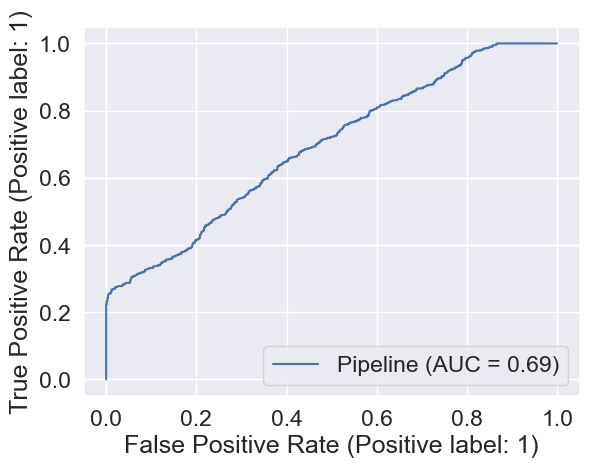

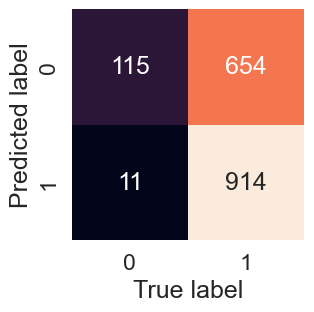

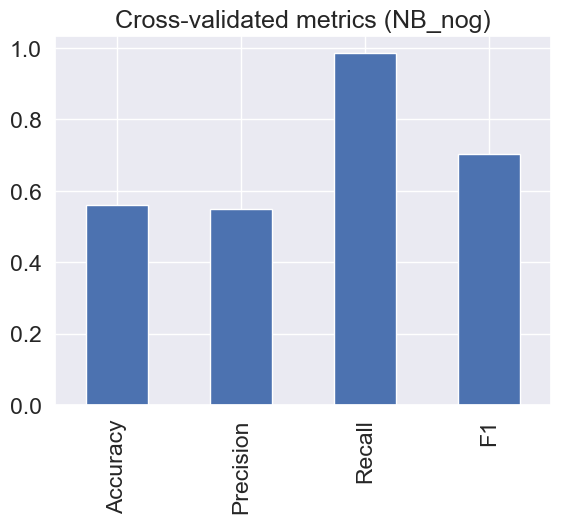

In [801]:
# Run for 'nog' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

no_gender_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

no_gender_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("nog", no_gender_transformer, no_gender_features),
    ])

X = no_gender_data.drop('success',axis=1)
y = no_gender_data['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=1000, fit_prior=False))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_nog is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_nog)', legend=False)

Accuracy score for NB_num is 0.5962219598583235
              precision    recall  f1-score   support

           0       0.55      0.59      0.57       769
           1       0.64      0.60      0.62       925

    accuracy                           0.60      1694
   macro avg       0.60      0.60      0.59      1694
weighted avg       0.60      0.60      0.60      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_num)'}>

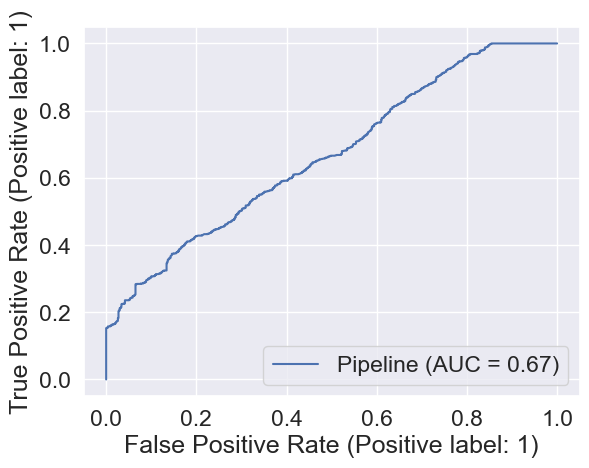

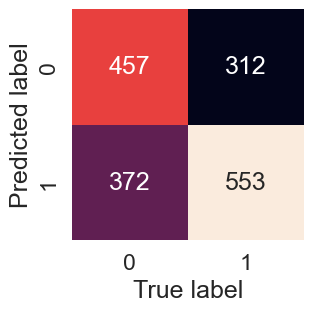

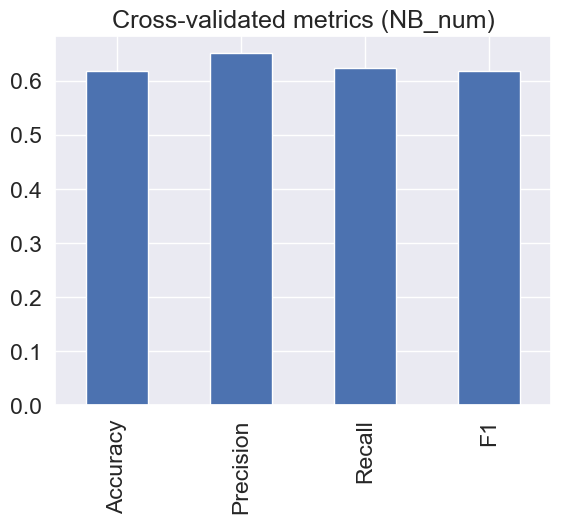

In [802]:
# Run for 'num' data:

# Define preprocessors


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[

        ("num", numeric_transformer, numeric_features)

    ])


X = num_data.drop('success',axis=1)
y = num_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=10, fit_prior=False))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_num is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_num)', legend=False)

Accuracy score for NB_ned is 0.5909090909090909
              precision    recall  f1-score   support

           0       0.61      0.28      0.38       769
           1       0.59      0.85      0.69       925

    accuracy                           0.59      1694
   macro avg       0.60      0.56      0.54      1694
weighted avg       0.60      0.59      0.55      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_ned)'}>

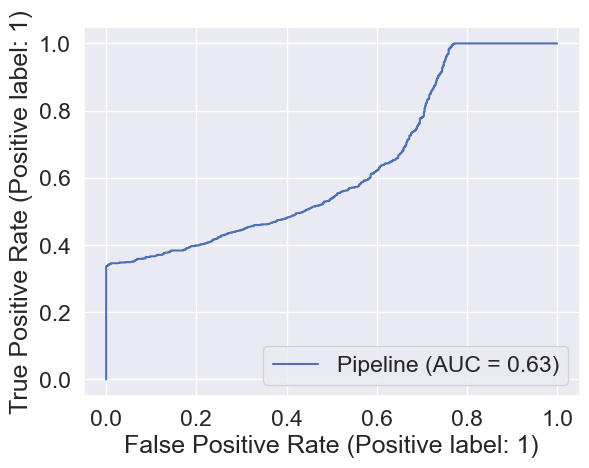

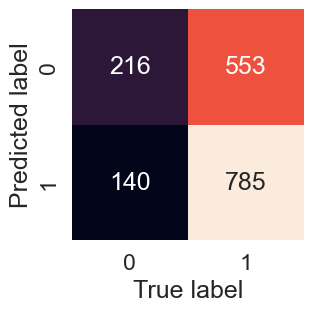

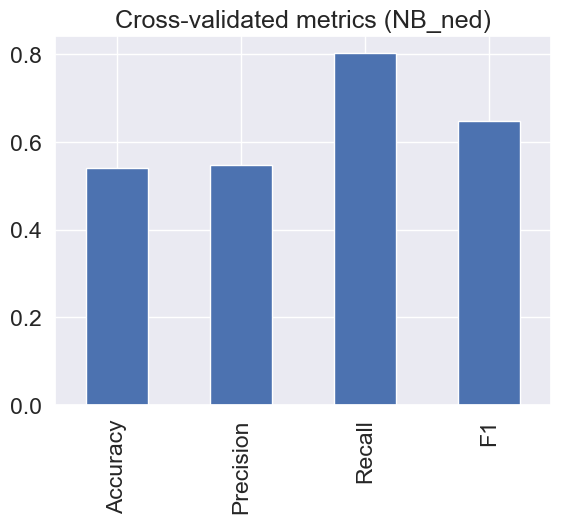

In [803]:
# Run for 'ned' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = no_enrich_df.drop('success',axis=1)
y = no_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=10))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_ned is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_ned)', legend=False)

Accuracy score for NB_sed is 0.5956316410861865
              precision    recall  f1-score   support

           0       0.62      0.28      0.39       769
           1       0.59      0.86      0.70       925

    accuracy                           0.60      1694
   macro avg       0.61      0.57      0.54      1694
weighted avg       0.60      0.60      0.56      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_sed)'}>

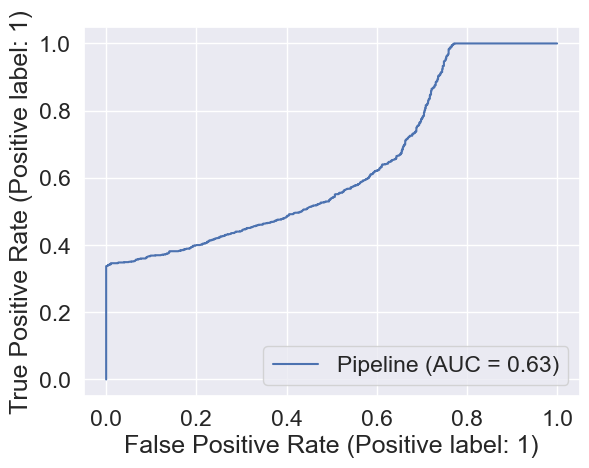

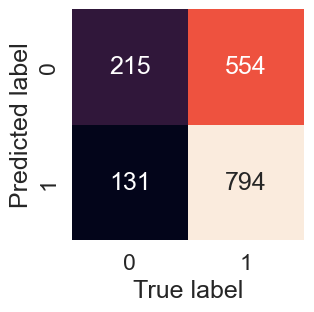

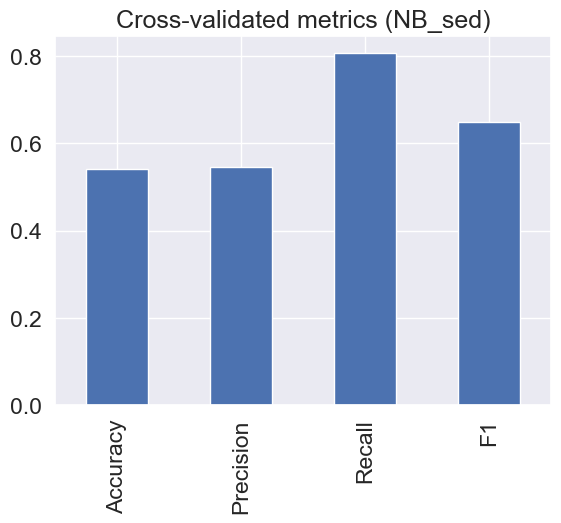

In [804]:
# Run for 'sed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = senti_enrich_df.drop('success',axis=1)
y = senti_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=10))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_sed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_sed)', legend=False)

Accuracy score for NB_fed is 0.5802833530106257
              precision    recall  f1-score   support

           0       0.57      0.29      0.39       769
           1       0.58      0.82      0.68       925

    accuracy                           0.58      1694
   macro avg       0.58      0.56      0.53      1694
weighted avg       0.58      0.58      0.55      1694



<AxesSubplot:title={'center':'Cross-validated metrics (NB_fed)'}>

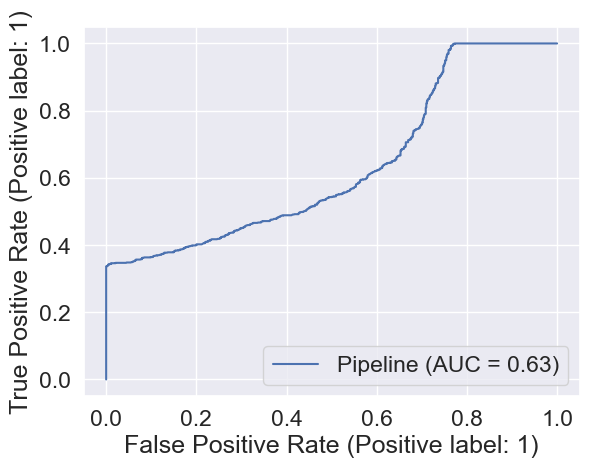

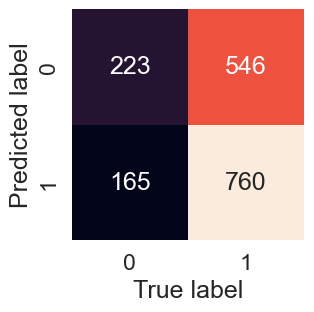

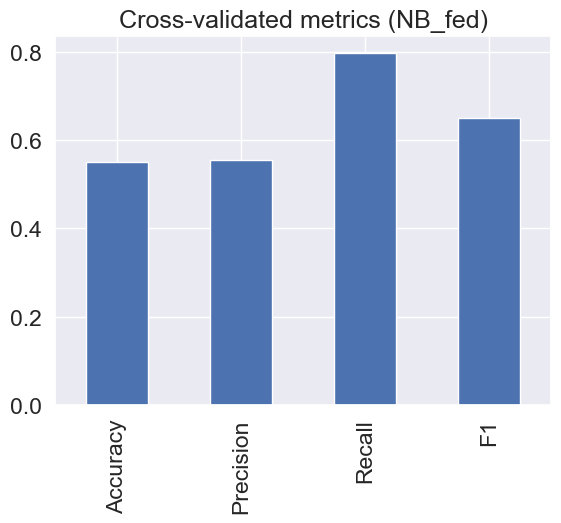

In [805]:
# Run for 'fed' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = follow_enrich_df.drop('success',axis=1)
y = follow_enrich_df['success']

# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", MultinomialNB(alpha=10))])

# Fit model
clf.fit(X_train, y_train)

# Predict 

y_preds = clf.predict(X_test)

# Plot the ROC curve and calculate the AUC metric

RocCurveDisplay.from_estimator(clf, X_test, y_test)



print(f'Accuracy score for NB_fed is {clf.score(X_test, y_test)}')


sns.set(font_scale=1.5)
    
plot_conf_mat(y_test, y_preds)

# Calculate the classification report 
print(classification_report(y_test, y_preds))

# Calculate the cross validated accuracy 
cv_acc = cross_val_score(clf,  X, y, cv=5, scoring='accuracy')
cv_acc = np.mean(cv_acc)
cv_acc

# Calculate the cross validated precision
cv_precision = cross_val_score(clf,  X, y, cv=5, scoring='precision')
cv_precision = np.mean(cv_precision)
cv_precision

# Calculate the cross validated recall 
cv_recall = cross_val_score(clf,  X, y, cv=5, scoring='recall')
cv_recall = np.mean(cv_recall)
cv_recall

# Calculate the cross validated F1 score
cv_f1 = cross_val_score(clf,  X, y, cv=5, scoring='f1')
cv_f1 = np.mean(cv_f1)
cv_f1

# Visualize cross-validated metrics
cv_metrics = pd.DataFrame({'Accuracy':cv_acc,
                          'Precision': cv_precision,
                          'Recall': cv_recall,
                          'F1': cv_f1}, index=[0])
cv_metrics.T.plot.bar(title='Cross-validated metrics (NB_fed)', legend=False)

**Feature Importance**

In [824]:
# Run for 'fd' data:

# Define preprocessors

# pipeline for text data1
text1_features = 'short_description_o'
text1_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data2
text2_features = 'description_o'
text2_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for text data3
text3_features = 'description_o'
text3_transformer = Pipeline(steps=[
    ('vectorizer', TfidfVectorizer(stop_words="english"))
])

# pipeline for categorical data

categorical_features = ['country_code_o', 'status','category_list','category_groups_list','uuid_p','gender','country_code_p',
                       'featured_job_title','institution_name','degree_type','subject','is_completed']

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='not known')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# pipeline for numeric data
numeric_features = ['following', 'followers','polarity','subjectivity','rank_o','rank_p','num_events_part','per_exp_at_coy_start',
                     'degree_length','employee_count_min','employee_count_max']
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="mean")), ("scaler", MinMaxScaler())])


preprocessor = ColumnTransformer(
    transformers=[
        ("tex1", text1_transformer, text1_features),
        ("tex2", text2_transformer, text2_features),
        ("tex3", text3_transformer, text3_features),
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ])

X = full_data.drop('success',axis=1)
y = full_data['success']


# Split into train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
# Set random seed
np.random.seed(42)

# Make a dictionary to keep model scores
model_score = {}
best_params = {}

# Fit the model to the data
clf = Pipeline(steps=[("preprocessor", preprocessor), ("clf", LogisticRegression(C=0.23357214690901212, max_iter=150,
                                    penalty='l1', solver='liblinear'))])

# Fit model
clf.fit(X_train, y_train)






Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tex1',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'short_description_o'),
                                                 ('tex2',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'description_o'),
                                                 ('tex3',
                                                  Pipeline(steps=[('vectorizer',
                                                                   TfidfVectorizer(stop_words='english'))]),
                                                  'descript...
                  

In [832]:
feature_names = clf.preprocessor.named_steps["vectorizer"].get_feature_names()

AttributeError: 'Pipeline' object has no attribute 'preprocessor'